In [13]:
#this is to learn and simulate 
#E and I nerons do not mix randomly 
#EI_network0807-unmix-optimise-batch-GLM-log_prop
import torch
import torch.optim as optim
import torch.nn as nn
import numpy as np
import math
import matplotlib.pyplot as plt
import pandas as pd
import torch.nn.functional as F
from numpy.linalg import inv
from mpl_toolkits.mplot3d import Axes3D


torch.manual_seed(42)



n=20
m=20
d=20

tao=100
dt = 1e-2
T=int(10/dt)

B=10
w=torch.randn(n,n, device='cpu', requires_grad=True,dtype=torch.float)

w2=torch.randn(d,d, device='cpu', requires_grad=True,dtype=torch.float)
lr = 1e-3
n_epochs = 10

optimizer = optim.Adam([w], lr=lr)
V=torch.zeros(T,n)
ep=np.arange(n_epochs)
Loss=torch.zeros(n_epochs,)
#generatiining the penalty matrix 
P1=(np.absolute(np.random.randint(low=2, high=100, size=math.ceil(n/2))))
p_ones=torch.ones(int(math.ceil(n/2)),dtype=torch.float)
p2s=torch.from_numpy(np.append(P1,p_ones))
p2ss=np.sort(p2s)
p2sss=p2ss[::-1]
p2=torch.from_numpy(p2sss.copy())

p3=torch.diag(p2)
p1=p3.type(dtype=torch.float)


b=torch.zeros(m,1,d)
mu=torch.zeros(m,1,n) #dimension m x1 xn
Lamda=torch.eye(n,n) #dimension n x n
L=torch.eye(d,d) #dimension d x d
A= torch.rand(n,d) #dimension n x d
bos=A@L@torch.transpose(A,0,1)
Sigma=torch.inverse(Lamda+bos)



for epoch in range(n_epochs):
   
  
    print (epoch)
    
    Tr1=torch.ones(int(math.ceil(n/2)),dtype=torch.float)
    Tr2=torch.ones(int(round(n/2)),dtype=torch.float)
    Tr=torch.cat((Tr1,-Tr2),0)
    Transform=torch.diag(Tr)
    #print (Transform.size())
    
    z_sample= torch.distributions.multivariate_normal.MultivariateNormal(mu,torch.inverse(Lamda))
    z1=z_sample.sample()
    z_softplus=F.softplus(z1)
    z=z_softplus@Transform
    
    #print (z)
    
   
    
    
    x_sample= torch.distributions.multivariate_normal.MultivariateNormal((z@A)+b, torch.inverse(L))
    x=x_sample.sample()
    
    
    
    




    w_softplus=F.softplus(w)
    wi=w_softplus@Transform
    w1=torch.diag(wi)
    w_rec=torch.diag(w1)
    w1_rec = wi-w_rec
    
    
    #print (w1_rec)


    
    loss=0
    for t in range(T):
        
        
        N=torch.randn(m,1,n)
        r=torch.relu(z)
        z_dot=(-z+(r@w1_rec+(x@w2))/math.sqrt(n))
        z = z + z_dot*dt+N*math.sqrt(dt)
    
        
       
        pos1=(x-b)@L@torch.transpose(A,0,1)+mu@Lamda
        pos2=pos1@Sigma
        pos_sample=torch.distributions.multivariate_normal.MultivariateNormal(pos2, Sigma)
        pos=pos_sample.sample()
        print (z)
        print (t)

        loss = loss - torch.mean((pos_sample.log_prob(z)))
        
    
    
    loss.backward()
    optimizer.step()
    optimizer.zero_grad()
    Loss[epoch]=loss
   
 







0
tensor([[[ 0.9201,  0.8604,  1.1122,  2.0890,  0.9181,  1.0066,  0.5981,
           1.5041,  0.4987,  0.4206, -0.7148, -2.2907, -0.2527, -0.5453,
          -1.6954, -0.5721, -0.7539, -1.4530, -1.6396, -1.3026]],

        [[ 0.4899,  0.9197,  0.7979,  0.5075, -0.0562,  0.9746,  0.4621,
           0.7880,  0.4803,  1.4374, -0.3745, -0.6134, -0.8424, -0.1594,
          -0.1119, -0.4601, -1.0305, -0.2813, -1.6257,  0.0620]],

        [[ 1.6072,  0.8425,  0.3459,  1.0847,  0.3061,  0.4834,  0.7836,
           1.0866,  0.3825,  0.9935, -0.3480, -0.5541, -0.5415, -1.3042,
          -0.9794, -1.4729, -1.1260, -0.4288, -0.3019, -0.7281]],

        [[ 0.4387,  0.4801,  1.1364,  2.4639,  0.3674,  0.3925,  0.8575,
           1.3096,  1.2900,  0.5313, -0.3496, -0.3178, -2.5095, -0.2629,
          -0.9471, -0.2362, -0.6286, -0.6694, -0.5025, -0.4271]],

        [[ 0.5964,  0.5534,  1.3172,  0.6994,  0.8948,  0.4833,  1.4090,
           0.8256,  0.4514,  0.5147, -0.6927, -0.3761, -0.7436, -1.9690,


tensor([[[ 0.5532,  0.2703,  0.1595,  0.8767,  0.9564,  1.5521,  0.8894,
           1.3006,  1.2032,  0.1957,  0.4829, -1.3035,  0.3881, -1.6280,
          -2.1075, -1.9523, -1.4654, -0.9836, -2.2531, -1.5716]],

        [[ 1.2194,  2.0876,  1.8397,  1.0613,  0.4928,  1.5530,  1.9432,
           2.6622,  1.1388,  0.4408, -0.6074, -1.2086, -0.9444, -0.8458,
          -0.8986, -1.3856, -0.2922, -0.6011, -1.6536, -0.6401]],

        [[ 0.5681,  1.1540,  0.1780,  1.1683,  1.1874,  1.0605,  1.4735,
           0.9292,  0.7122,  1.1652, -0.0978,  0.4227, -1.1387, -1.2921,
          -0.8409, -1.0860, -0.8244, -0.4499, -0.6997, -1.9363]],

        [[ 1.9112,  2.1936,  1.1190,  2.8194,  1.3006,  0.1864,  1.2727,
           2.6711,  2.5039, -0.9257, -1.3600, -0.1860, -4.3398, -2.1558,
          -2.5350, -1.0660, -1.2682, -0.9002, -0.5877, -0.6028]],

        [[ 1.0155,  0.6084,  1.4242,  0.6937,  0.9537,  0.4259,  1.2440,
           0.0711,  0.6499,  0.4552,  0.1510, -1.5716, -1.0064, -2.2043,
  

tensor([[[ 1.0050e+00,  4.1498e-01,  1.0839e+00,  8.6490e-01,  5.8176e-01,
           1.0628e+00,  3.1195e-01,  8.7605e-01,  1.9076e+00,  6.0725e-01,
          -1.9161e-01, -1.1540e+00,  2.0210e+00, -1.0355e+00, -2.0466e+00,
          -2.6861e+00, -2.2948e+00, -4.9033e-01, -2.7038e+00, -1.7551e+00]],

        [[ 6.8946e-01,  3.5091e+00,  3.0131e+00,  1.9645e+00,  1.6582e+00,
           1.7092e+00,  3.1632e+00,  4.1792e+00,  2.5357e+00,  5.4237e-01,
          -1.4635e+00, -1.2412e+00, -2.2416e+00, -1.5692e+00, -2.5840e+00,
          -2.2726e+00, -3.9698e-01, -6.4710e-02, -2.6786e+00, -2.5073e+00]],

        [[ 1.1331e-01,  1.6991e+00, -3.4977e-01,  1.7416e+00,  2.2272e+00,
           1.6071e+00,  2.8131e+00,  1.8652e+00,  1.5255e+00,  1.4828e+00,
          -3.6097e-01,  1.7231e-01, -2.3159e+00, -2.6858e+00, -1.0263e+00,
          -9.3461e-01, -1.4958e+00, -1.1146e+00, -1.1361e+00, -2.1355e+00]],

        [[ 1.9501e+00,  2.2988e+00,  2.5441e+00,  3.7404e+00,  1.2291e+00,
          -3.214

tensor([[[  1.4150,   0.4170,   1.0947,   2.3530,   0.1932,   0.4560,   1.5967,
            2.1090,   1.8826,   0.7197,   0.3318,  -1.1375,   1.3140,  -1.8534,
           -2.9420,  -4.5301,  -2.9383,  -2.3597,  -2.5732,  -3.7049]],

        [[  1.3868,   3.9495,   3.9739,   3.8279,   2.8980,   1.9024,   5.3812,
            4.3688,   4.8476,   0.6916,  -2.7783,  -2.0686,  -3.5677,  -2.8619,
           -4.5102,  -2.3667,  -0.5902,  -1.6201,  -4.3638,  -3.3070]],

        [[  0.6426,   2.8326,  -0.1094,   1.6464,   2.4255,   1.5787,   2.6727,
            2.0387,   2.2805,   1.7998,  -1.2377,   0.1099,  -3.2158,  -2.8432,
           -2.5857,  -1.8287,  -2.7106,  -2.1237,  -2.7295,  -2.0753]],

        [[  2.7095,   3.9781,   3.3371,   4.2069,   0.8801,   0.3087,   2.4693,
            6.2650,   4.1195,  -0.9388,  -4.5255,  -3.1343,  -4.4787,  -6.3171,
           -3.3325,  -3.6812,  -1.6496,  -1.2109,  -1.5438,  -4.3294]],

        [[  2.1434,   3.1108,   2.3398,   2.1140,   1.6344,   2.0149

tensor([[[ 1.5241e-01,  1.1565e-01,  1.6104e+00,  2.2392e+00,  4.8485e-01,
           1.6408e-01,  1.0163e+00,  1.8524e+00,  2.6775e+00,  1.6571e+00,
           4.4301e-02, -2.9174e-01,  1.2678e+00, -2.8178e+00, -2.2828e+00,
          -3.9708e+00, -2.3620e+00, -2.1957e+00, -2.8521e+00, -3.5559e+00]],

        [[ 1.7137e+00,  5.7256e+00,  4.7147e+00,  5.2853e+00,  5.0454e+00,
           4.6712e+00,  6.3431e+00,  6.1129e+00,  6.9337e+00,  2.9273e+00,
          -4.5096e+00, -4.6114e+00, -4.2248e+00, -4.9466e+00, -5.3311e+00,
          -5.0493e+00, -4.7061e-01, -3.0280e+00, -5.6220e+00, -3.9350e+00]],

        [[ 1.3806e+00,  3.6829e+00, -1.4758e-01,  1.9959e+00,  2.3502e+00,
           2.1999e+00,  2.9872e+00,  3.6829e+00,  2.7343e+00,  1.5472e+00,
          -7.8165e-01, -1.1886e+00, -2.6812e+00, -3.3997e+00, -2.6999e+00,
          -2.7611e+00, -3.1913e+00, -2.7404e+00, -3.4490e+00, -2.7245e+00]],

        [[ 1.6667e+00,  5.7090e+00,  3.3811e+00,  5.4501e+00,  2.5074e+00,
           2.457

tensor([[[ 9.1132e-01,  6.4113e-01,  1.3078e+00,  1.7991e+00,  8.7028e-01,
           7.8434e-01,  1.3241e+00,  1.3415e+00,  2.0206e+00,  1.7090e-02,
          -3.7749e-01, -1.8969e-01,  2.0602e+00, -3.5841e+00, -2.0624e+00,
          -4.9488e+00, -2.5952e+00, -2.8311e+00, -3.1576e+00, -5.7939e+00]],

        [[ 3.0288e+00,  8.1915e+00,  7.0987e+00,  7.6152e+00,  7.9073e+00,
           7.7210e+00,  9.2569e+00,  8.2980e+00,  9.0474e+00,  5.0053e+00,
          -6.6977e+00, -7.4832e+00, -5.1778e+00, -7.7228e+00, -8.7105e+00,
          -9.0577e+00, -3.1762e+00, -5.8773e+00, -6.0005e+00, -6.6093e+00]],

        [[ 2.5056e+00,  3.4594e+00,  1.3603e+00,  3.1874e+00,  4.1589e+00,
           3.3364e+00,  5.2252e+00,  4.3818e+00,  4.3658e+00,  3.3096e+00,
          -1.6007e+00, -1.9320e+00, -4.1051e+00, -4.8182e+00, -4.0336e+00,
          -3.6722e+00, -3.6912e+00, -3.9447e+00, -4.0522e+00, -4.3606e+00]],

        [[ 3.7447e+00,  7.9128e+00,  5.3459e+00,  7.3316e+00,  5.4142e+00,
           4.944

tensor([[[ 2.2291e+00,  1.3061e+00,  1.6659e+00,  2.0292e+00,  1.1741e+00,
           1.1847e+00,  9.0203e-01,  7.7186e-01,  2.0753e+00,  1.4047e+00,
          -2.9931e-01, -9.8922e-01,  1.1740e+00, -3.7847e+00, -2.5416e+00,
          -5.8327e+00, -1.8523e+00, -2.3958e+00, -3.9673e+00, -5.5351e+00]],

        [[ 5.7860e+00,  1.2990e+01,  9.7374e+00,  1.1114e+01,  1.0989e+01,
           1.1698e+01,  1.4498e+01,  1.1905e+01,  1.2706e+01,  9.3923e+00,
          -1.0219e+01, -1.0607e+01, -7.5626e+00, -1.2334e+01, -1.2832e+01,
          -1.6271e+01, -6.2310e+00, -8.7730e+00, -7.8090e+00, -1.1605e+01]],

        [[ 3.4187e+00,  5.5287e+00,  1.8452e+00,  4.2404e+00,  6.6603e+00,
           4.4925e+00,  8.3309e+00,  5.2816e+00,  7.2377e+00,  5.0840e+00,
          -3.5115e+00, -3.7815e+00, -4.6692e+00, -5.9987e+00, -6.4159e+00,
          -5.9083e+00, -4.4756e+00, -4.8317e+00, -5.2884e+00, -7.7914e+00]],

        [[ 5.1349e+00,  1.0483e+01,  7.4196e+00,  9.8011e+00,  7.3510e+00,
           7.804

tensor([[[ 1.8923e+00,  1.5115e+00,  1.8146e+00,  1.0790e+00,  6.3407e-01,
           1.2557e+00,  7.3905e-01,  8.0382e-02,  1.8263e+00,  1.3601e+00,
           6.6123e-02, -7.1993e-01,  1.0691e+00, -4.1431e+00, -2.8395e+00,
          -6.0774e+00, -1.7712e+00, -2.6012e+00, -4.7730e+00, -5.9146e+00]],

        [[ 1.0248e+01,  1.9081e+01,  1.4047e+01,  1.6289e+01,  1.6720e+01,
           1.7992e+01,  2.1079e+01,  1.6574e+01,  1.9066e+01,  1.5750e+01,
          -1.5320e+01, -1.6655e+01, -1.1596e+01, -1.8894e+01, -1.8446e+01,
          -2.3684e+01, -1.1759e+01, -1.3962e+01, -1.1841e+01, -1.8867e+01]],

        [[ 4.2202e+00,  7.6388e+00,  4.5853e+00,  6.0928e+00,  8.9063e+00,
           8.3796e+00,  1.0644e+01,  7.8532e+00,  9.5392e+00,  6.9844e+00,
          -5.5732e+00, -4.8305e+00, -6.1258e+00, -8.5787e+00, -8.0511e+00,
          -1.0138e+01, -6.7265e+00, -7.1851e+00, -7.2175e+00, -1.0037e+01]],

        [[ 7.2377e+00,  1.4423e+01,  1.1050e+01,  1.2291e+01,  1.0732e+01,
           1.116

tensor([[[ 2.3826e+00,  1.4694e+00,  1.9109e+00,  1.9289e+00,  1.5331e+00,
           2.3214e+00,  1.4469e+00,  1.4433e+00,  2.2247e+00,  2.1005e+00,
          -7.0008e-01, -9.9235e-01,  2.0860e-01, -4.1143e+00, -3.1258e+00,
          -5.6647e+00, -2.1401e+00, -3.4731e+00, -5.0736e+00, -4.4670e+00]],

        [[ 1.4501e+01,  2.7713e+01,  1.9673e+01,  2.3732e+01,  2.4510e+01,
           2.5081e+01,  2.9597e+01,  2.3446e+01,  2.7987e+01,  2.4935e+01,
          -2.1414e+01, -2.5315e+01, -1.7813e+01, -2.7388e+01, -2.6946e+01,
          -3.4687e+01, -1.9479e+01, -2.0854e+01, -1.7627e+01, -2.7401e+01]],

        [[ 6.2218e+00,  1.1031e+01,  9.6059e+00,  8.4483e+00,  1.2934e+01,
           1.1538e+01,  1.3399e+01,  1.0993e+01,  1.1851e+01,  1.0713e+01,
          -8.3399e+00, -7.3451e+00, -7.6531e+00, -1.2956e+01, -1.1455e+01,
          -1.5736e+01, -9.8275e+00, -1.0625e+01, -8.9368e+00, -1.3228e+01]],

        [[ 1.0935e+01,  1.9992e+01,  1.4686e+01,  1.7114e+01,  1.6603e+01,
           1.695

tensor([[[ 2.9770e+00,  2.2801e+00,  1.9436e+00,  1.5267e+00,  2.4754e+00,
           2.5906e+00,  2.4568e+00,  2.0457e+00,  2.5510e+00,  1.7491e+00,
          -1.5070e+00, -1.8814e+00, -7.8519e-01, -4.3240e+00, -3.7717e+00,
          -5.8740e+00, -1.9259e+00, -3.4112e+00, -4.4288e+00, -5.3089e+00]],

        [[ 2.2016e+01,  4.1367e+01,  2.8087e+01,  3.3386e+01,  3.6975e+01,
           3.7364e+01,  4.2500e+01,  3.2833e+01,  3.9722e+01,  3.6445e+01,
          -3.0108e+01, -3.6865e+01, -2.6929e+01, -3.9524e+01, -3.9070e+01,
          -5.1917e+01, -2.9917e+01, -3.0499e+01, -2.4764e+01, -4.0570e+01]],

        [[ 9.3709e+00,  1.5734e+01,  1.1941e+01,  1.2417e+01,  1.6290e+01,
           1.7027e+01,  1.9317e+01,  1.5401e+01,  1.7431e+01,  1.5413e+01,
          -1.1031e+01, -1.3259e+01, -1.0976e+01, -1.8376e+01, -1.6199e+01,
          -2.2195e+01, -1.3069e+01, -1.3751e+01, -1.1910e+01, -1.8189e+01]],

        [[ 1.5361e+01,  2.9591e+01,  2.1092e+01,  2.3768e+01,  2.5221e+01,
           2.511

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([[[ 2.3759e+01,  3.8815e+01,  2.8849e+01,  3.0955e+01,  3.5793e+01,
           4.0076e+01,  4.1352e+01,  3.1573e+01,  3.9247e+01,  3.8640e+01,
          -2.9018e+01, -3.6823e+01, -2.4358e+01, -4.1278e+01, -4.0488e+01,
          -5.6521e+01, -3.4605e+01, -3.2272e+01, -2.8041e+01, -4.4392e+01]],

        [[ 4.1611e+02,  7.5877e+02,  5.5255e+02,  5.9399e+02,  6.9520e+02,
           7.4155e+02,  7.7143e+02,  6.0228e+02,  7.4481e+02,  7.5186e+02,
          -5.5497e+02, -7.2015e+02, -4.9296e+02, -7.4861e+02, -7.1683e+02,
          -1.0117e+03, -6.2586e+02, -5.8471e+02, -4.7933e+02, -7.7281e+02]],

        [[ 1.6690e+02,  3.0340e+02,  2.1919e+02,  2.3698e+02,  2.7914e+02,
           2.9639e+02,  3.1027e+02,  2.4171e+02,  2.9792e+02,  3.0216e+02,
          -2.2133e+02, -2.8764e+02, -1.9733e+02, -3.0197e+02, -2.8751e+02,
          -4.0453e+02, -2.5173e+02, -2.3481e+02, -1.9155e+02, -3.1176e+02]],

        [[ 2.8882e+02,  5.2666e+02,  3.8167e+02,  4.1307e+02,  4.8035e+02,
           5.120

tensor([[[ 3.3324e+01,  5.7277e+01,  4.3021e+01,  4.5189e+01,  5.2506e+01,
           5.7828e+01,  5.9295e+01,  4.5585e+01,  5.7549e+01,  5.6428e+01,
          -4.1400e+01, -5.2793e+01, -3.5617e+01, -5.9011e+01, -5.6932e+01,
          -7.9550e+01, -4.9309e+01, -4.6853e+01, -3.8980e+01, -6.2159e+01]],

        [[ 6.0879e+02,  1.1090e+03,  8.0648e+02,  8.6930e+02,  1.0146e+03,
           1.0851e+03,  1.1276e+03,  8.8053e+02,  1.0905e+03,  1.1025e+03,
          -8.1087e+02, -1.0540e+03, -7.2093e+02, -1.0950e+03, -1.0473e+03,
          -1.4809e+03, -9.1439e+02, -8.5530e+02, -7.0192e+02, -1.1311e+03]],

        [[ 2.4443e+02,  4.4307e+02,  3.2164e+02,  3.4722e+02,  4.0731e+02,
           4.3433e+02,  4.5224e+02,  3.5253e+02,  4.3670e+02,  4.4193e+02,
          -3.2357e+02, -4.1965e+02, -2.8835e+02, -4.3955e+02, -4.2028e+02,
          -5.9231e+02, -3.6661e+02, -3.4255e+02, -2.8178e+02, -4.5423e+02]],

        [[ 4.2242e+02,  7.6968e+02,  5.5886e+02,  6.0375e+02,  7.0277e+02,
           7.500

tensor([[[ 4.8293e+01,  8.4854e+01,  6.1315e+01,  6.5517e+01,  7.7287e+01,
           8.3790e+01,  8.7179e+01,  6.7731e+01,  8.3484e+01,  8.3586e+01,
          -6.0809e+01, -7.7781e+01, -5.3809e+01, -8.4301e+01, -8.2385e+01,
          -1.1571e+02, -7.1373e+01, -6.8125e+01, -5.6057e+01, -8.9752e+01]],

        [[ 8.8990e+02,  1.6220e+03,  1.1781e+03,  1.2711e+03,  1.4854e+03,
           1.5879e+03,  1.6493e+03,  1.2874e+03,  1.5942e+03,  1.6123e+03,
          -1.1863e+03, -1.5416e+03, -1.0525e+03, -1.6010e+03, -1.5315e+03,
          -2.1659e+03, -1.3385e+03, -1.2531e+03, -1.0238e+03, -1.6543e+03]],

        [[ 3.5621e+02,  6.4852e+02,  4.7118e+02,  5.0749e+02,  5.9486e+02,
           6.3520e+02,  6.6056e+02,  5.1597e+02,  6.3786e+02,  6.4614e+02,
          -4.7389e+02, -6.1448e+02, -4.2130e+02, -6.4255e+02, -6.1327e+02,
          -8.6654e+02, -5.3669e+02, -5.0152e+02, -4.1149e+02, -6.6399e+02]],

        [[ 6.1758e+02,  1.1246e+03,  8.1545e+02,  8.8143e+02,  1.0276e+03,
           1.096

tensor([[[ 6.9733e+01,  1.2308e+02,  8.9991e+01,  9.5419e+01,  1.1233e+02,
           1.2059e+02,  1.2483e+02,  9.7093e+01,  1.1998e+02,  1.2219e+02,
          -8.9284e+01, -1.1457e+02, -7.8988e+01, -1.2261e+02, -1.1710e+02,
          -1.6655e+02, -1.0276e+02, -9.6555e+01, -7.9624e+01, -1.2793e+02]],

        [[ 1.2917e+03,  2.3541e+03,  1.7097e+03,  1.8425e+03,  2.1548e+03,
           2.3038e+03,  2.3922e+03,  1.8668e+03,  2.3131e+03,  2.3416e+03,
          -1.7212e+03, -2.2364e+03, -1.5264e+03, -2.3241e+03, -2.2228e+03,
          -3.1446e+03, -1.9443e+03, -1.8189e+03, -1.4865e+03, -2.4027e+03]],

        [[ 5.1622e+02,  9.4009e+02,  6.8267e+02,  7.3625e+02,  8.6227e+02,
           9.2137e+02,  9.5679e+02,  7.4730e+02,  9.2566e+02,  9.3691e+02,
          -6.8738e+02, -8.9264e+02, -6.1117e+02, -9.3117e+02, -8.8977e+02,
          -1.2591e+03, -7.7786e+02, -7.2913e+02, -5.9619e+02, -9.6259e+02]],

        [[ 8.9543e+02,  1.6310e+03,  1.1843e+03,  1.2780e+03,  1.4909e+03,
           1.593

1
tensor([[[ 0.3671,  0.3391,  1.5230,  0.7480,  0.4550,  0.5683,  1.0007,
           0.2208,  1.8737,  0.3843, -1.0008, -0.4077, -0.4367, -0.4223,
          -0.8223, -0.4022, -0.4604, -0.1388, -0.8378, -0.1816]],

        [[ 0.6940,  0.2209,  1.7373,  0.2423,  2.8983,  1.2578,  1.0561,
           0.8125,  0.8869,  0.4928, -0.7580, -1.0742, -0.1735, -3.0685,
          -0.3454, -1.1375, -0.6573, -0.2576, -0.4640, -0.6960]],

        [[ 0.4131,  1.6689,  0.2337,  0.7922,  0.6758,  1.5721,  0.2934,
           0.5586,  1.4157,  0.6227, -0.8549, -0.7245, -1.8099, -0.4980,
          -0.4837, -0.4390, -0.5304, -1.7150, -0.2895, -0.2531]],

        [[ 0.6972,  0.4182,  0.2604,  0.0362,  1.3997,  0.6018,  1.3934,
           0.9204,  0.1524,  0.7718, -0.6881, -0.9259, -0.9149, -0.1878,
          -0.0543, -0.2743, -0.6572, -0.6300, -0.4152, -0.7947]],

        [[ 0.4872,  0.7227,  0.5623,  0.0838,  0.9700,  0.7219,  0.4380,
           0.2255,  2.0864,  1.2729, -1.4591, -0.7545, -0.4938, -0.8124,


tensor([[[-3.9234e-01,  2.1197e+00,  1.9201e+00,  2.4515e+00, -7.3901e-01,
          -7.8270e-01,  1.0100e+00,  1.7082e+00,  3.1513e+00,  9.4850e-01,
          -2.9186e+00, -9.8707e-01, -1.5661e+00, -4.1094e+00, -2.4327e+00,
          -1.2704e+00,  2.8837e-01, -4.1389e-01,  2.7396e-01, -1.0620e+00]],

        [[ 1.1200e+00,  1.3787e+00,  1.5868e+00,  1.7147e+00,  3.4239e+00,
           4.7574e-01, -4.2242e-01,  1.2067e+00,  3.8023e+00,  5.7493e-01,
          -2.1165e+00, -1.0386e+00, -9.5791e-01, -3.9474e+00, -2.8732e+00,
          -2.2809e+00,  1.3337e-01, -1.0877e+00, -8.3931e-01, -1.9415e+00]],

        [[ 3.3938e-02, -8.2008e-01, -5.1181e-01,  6.3475e-01,  1.0690e+00,
           4.7172e-01, -6.0875e-01,  1.5722e+00,  2.2901e+00,  6.0226e-01,
          -1.1940e+00, -1.0617e+00, -2.6314e+00, -9.8169e-01, -1.4496e+00,
          -5.3399e-01,  1.0027e+00, -2.4526e+00, -3.2113e-01, -7.1190e-01]],

        [[-1.5338e+00,  2.6417e-01,  4.5353e-01, -6.0564e-01,  1.0795e+00,
           2.567

tensor([[[ 7.2425e-01,  4.4420e+00,  3.0389e+00,  3.7373e+00,  1.0709e+00,
           9.4749e-01,  1.8927e+00,  3.5316e+00,  4.1770e+00, -7.9887e-02,
          -5.0880e+00, -2.5183e+00, -2.2859e+00, -6.4409e+00, -3.5429e+00,
          -2.1528e+00,  1.9598e-01, -2.7066e-01,  7.9729e-03, -2.2945e+00]],

        [[ 1.1289e+00,  2.0782e+00,  2.4222e+00,  2.1864e+00,  4.1436e+00,
           3.6115e-01,  7.0445e-01,  1.5185e+00,  4.8525e+00,  1.3015e-01,
          -2.4755e+00, -1.8782e+00, -1.2065e+00, -4.2520e+00, -4.4099e+00,
          -3.5797e+00,  1.4945e+00, -2.4423e+00, -8.4297e-01, -1.8904e+00]],

        [[ 4.6319e-01, -1.0383e+00, -7.6944e-01,  8.6393e-01,  1.3330e+00,
          -4.1708e-01, -1.1832e+00,  1.7133e+00,  2.1733e+00, -3.6060e-01,
          -1.1947e+00, -3.7206e-01, -2.5995e+00, -1.4074e+00, -4.0476e-01,
          -1.7631e+00,  2.9243e+00, -1.7425e+00, -8.9378e-01, -8.4294e-01]],

        [[-1.4007e+00, -4.1934e-01, -3.8156e-01,  1.9312e-01,  1.5462e+00,
           4.948

tensor([[[ 1.9953e+00,  5.7123e+00,  3.4912e+00,  4.8654e+00,  3.4664e+00,
           2.1102e+00,  4.5146e+00,  5.6117e+00,  5.5243e+00,  2.1074e+00,
          -5.9749e+00, -3.9933e+00, -4.6929e+00, -8.9099e+00, -5.5635e+00,
          -3.4899e+00, -1.5848e+00, -6.2552e-01, -6.2954e-01, -4.8377e+00]],

        [[ 1.6954e+00,  2.6940e+00,  3.2022e+00,  1.7776e+00,  4.0364e+00,
           1.4254e-01,  9.0721e-01,  1.8096e+00,  4.9460e+00,  1.4377e+00,
          -3.3352e+00, -2.4971e+00, -1.8051e+00, -5.6683e+00, -5.1145e+00,
          -4.4871e+00,  1.7124e+00, -3.6758e+00, -1.2181e+00, -4.0842e+00]],

        [[ 6.1749e-02,  6.2530e-01, -2.0173e-01,  7.2203e-01,  2.1192e+00,
          -8.1241e-01, -8.3866e-01,  1.8271e+00,  3.3040e+00, -2.8404e-01,
          -8.2854e-01,  1.7501e-01, -3.1522e+00, -2.7075e+00, -8.6258e-01,
          -2.6234e+00,  3.2089e+00, -2.0024e+00, -1.7732e+00, -6.5392e-01]],

        [[-2.0465e+00,  1.0143e-01, -8.1215e-01,  6.1484e-01,  1.9841e+00,
          -5.575

tensor([[[ 3.8002e+00,  9.2284e+00,  5.9209e+00,  6.7227e+00,  6.1237e+00,
           4.2988e+00,  7.4044e+00,  7.3821e+00,  7.9828e+00,  5.1590e+00,
          -9.0977e+00, -6.1985e+00, -5.8382e+00, -1.1836e+01, -8.7973e+00,
          -7.6469e+00, -2.7633e+00, -2.9940e+00, -1.8035e+00, -6.5056e+00]],

        [[ 1.3125e+00,  4.0624e+00,  3.2449e+00,  2.0645e+00,  4.1043e+00,
           1.3161e+00,  2.4861e+00,  2.6969e+00,  6.8373e+00,  1.9665e+00,
          -4.0384e+00, -3.6338e+00, -2.9215e+00, -5.1640e+00, -5.8263e+00,
          -6.8943e+00,  7.8979e-01, -4.1580e+00, -2.2745e+00, -4.2740e+00]],

        [[-7.1795e-02, -3.7018e-01,  5.5270e-01,  1.4267e-01,  1.9764e+00,
          -1.2817e+00,  2.4705e-01,  1.9930e+00,  3.5264e+00,  2.1788e-01,
          -1.5702e+00, -3.2129e-02, -3.9863e+00, -2.9439e+00, -2.5468e+00,
          -1.8694e+00,  2.9970e+00, -1.6264e+00, -1.7654e+00, -2.3021e+00]],

        [[-1.4576e+00, -2.6806e-02, -5.2895e-01,  1.3286e-01,  1.0804e+00,
          -3.926

tensor([[[  5.0195,  12.5662,   8.5959,   9.5174,   8.8061,   7.4903,  10.5938,
           10.3880,  11.9866,   8.3636, -11.2829, -10.2466,  -8.3849, -15.0291,
          -11.3156, -12.5316,  -4.6838,  -6.5102,  -3.4589,  -9.1310]],

        [[  3.0619,   5.1774,   4.2674,   3.4979,   5.2170,   3.0425,   3.6136,
            4.0344,   7.5747,   2.7537,  -5.0024,  -4.1497,  -3.2321,  -6.1357,
           -7.8236,  -8.1525,   0.2400,  -4.3139,  -2.8205,  -4.5603]],

        [[  0.1612,   0.9040,   0.2223,  -0.1908,   2.2948,  -0.4816,   0.7968,
            1.9423,   3.7234,  -0.3404,  -2.0420,  -0.2151,  -4.1933,  -3.2663,
           -2.5278,  -3.1064,   1.8962,  -2.6359,  -2.2309,  -3.6393]],

        [[ -1.7537,  -0.1413,  -0.3633,   0.3214,  -0.2237,  -1.1293,   0.2416,
            2.8168,   2.4230,   0.2827,  -1.5660,   0.6561,   2.1858,  -3.0507,
           -2.5357,  -1.5139,  -0.0867,  -1.3527,  -0.2300,  -4.9913]],

        [[ -1.2262,   1.7285,   2.5356,   1.5253,   1.4071,  -0.7610

tensor([[[ 8.6240e+00,  1.7219e+01,  1.4418e+01,  1.4859e+01,  1.3285e+01,
           1.3415e+01,  1.5171e+01,  1.5263e+01,  1.6925e+01,  1.4490e+01,
          -1.6512e+01, -1.5629e+01, -1.1526e+01, -2.0689e+01, -1.6756e+01,
          -1.9365e+01, -1.0122e+01, -1.1656e+01, -6.6902e+00, -1.4790e+01]],

        [[ 4.7313e+00,  8.2155e+00,  5.9253e+00,  6.2229e+00,  7.4266e+00,
           5.0981e+00,  6.1936e+00,  6.8624e+00,  1.0031e+01,  4.9429e+00,
          -7.1223e+00, -7.1010e+00, -4.7949e+00, -8.6137e+00, -1.0442e+01,
          -1.0335e+01, -2.5295e+00, -6.6220e+00, -3.5060e+00, -7.0827e+00]],

        [[ 1.4607e-02, -3.3131e-01,  9.2404e-01,  1.3427e+00,  2.2213e+00,
          -2.7830e-01,  3.5676e-01,  2.3212e+00,  4.8486e+00, -5.9509e-01,
          -1.7628e+00,  5.5684e-01, -3.5778e+00, -4.1377e+00, -2.9010e+00,
          -3.5466e+00,  1.7673e+00, -3.3068e+00, -1.8850e+00, -2.8811e+00]],

        [[-9.6425e-01,  6.1872e-02, -4.6491e-01,  4.7539e-01, -7.1937e-01,
          -1.483

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([[[ 1.2963e+02,  2.3764e+02,  1.7337e+02,  1.8585e+02,  2.1396e+02,
           2.2797e+02,  2.3759e+02,  1.8862e+02,  2.3198e+02,  2.3330e+02,
          -1.7558e+02, -2.2337e+02, -1.5274e+02, -2.3871e+02, -2.2276e+02,
          -3.1359e+02, -1.9163e+02, -1.7913e+02, -1.4638e+02, -2.3979e+02]],

        [[ 4.9015e+01,  8.9675e+01,  6.4113e+01,  7.0832e+01,  8.3575e+01,
           8.4587e+01,  8.9673e+01,  7.1575e+01,  9.0877e+01,  8.5949e+01,
          -6.7372e+01, -8.5570e+01, -5.7672e+01, -9.1269e+01, -8.7183e+01,
          -1.2007e+02, -6.8779e+01, -7.1180e+01, -5.5984e+01, -9.2678e+01]],

        [[-2.2013e-01,  3.3019e-01,  2.6247e+00,  1.4756e+00,  2.6234e+00,
           2.0389e+00,  2.0813e+00,  1.6149e+00,  4.9924e+00, -6.8386e-01,
          -2.7422e+00, -1.1000e+00, -4.1345e+00, -4.9965e+00, -5.3072e+00,
          -5.1586e+00,  1.9356e+00, -2.5596e+00, -1.8398e+00, -2.0869e+00]],

        [[-1.8696e+00,  2.1504e+00,  1.0644e+00,  5.8195e-01,  1.3751e+00,
          -1.160

tensor([[[ 1.8822e+02,  3.4396e+02,  2.5000e+02,  2.7034e+02,  3.1089e+02,
           3.3248e+02,  3.4595e+02,  2.7308e+02,  3.3656e+02,  3.3912e+02,
          -2.5364e+02, -3.2519e+02, -2.2280e+02, -3.4330e+02, -3.2302e+02,
          -4.5594e+02, -2.8089e+02, -2.6084e+02, -2.1313e+02, -3.4877e+02]],

        [[ 6.9712e+01,  1.2916e+02,  9.3851e+01,  1.0203e+02,  1.1910e+02,
           1.2462e+02,  1.2953e+02,  1.0188e+02,  1.3031e+02,  1.2664e+02,
          -9.6049e+01, -1.2255e+02, -8.4471e+01, -1.2951e+02, -1.2433e+02,
          -1.7375e+02, -1.0235e+02, -1.0215e+02, -8.0231e+01, -1.3313e+02]],

        [[-4.2154e-02, -3.2657e-01,  3.1308e+00,  1.0585e+00,  2.8795e+00,
           3.0387e+00,  2.0214e+00,  2.1311e+00,  5.8035e+00,  5.0867e-01,
          -2.9889e+00, -2.2351e+00, -4.0911e+00, -5.3778e+00, -7.1206e+00,
          -4.8300e+00,  6.3230e-01, -4.2272e+00, -2.6590e+00, -3.2949e+00]],

        [[-1.8741e+00,  1.6308e+00,  2.1544e+00,  1.3022e+00,  1.7771e+00,
           6.337

tensor([[[ 2.7015e+02,  4.9513e+02,  3.5931e+02,  3.8917e+02,  4.5040e+02,
           4.7980e+02,  4.9880e+02,  3.9341e+02,  4.8441e+02,  4.8866e+02,
          -3.6305e+02, -4.6865e+02, -3.2107e+02, -4.9322e+02, -4.6616e+02,
          -6.5786e+02, -4.0495e+02, -3.7797e+02, -3.0851e+02, -5.0253e+02]],

        [[ 1.0102e+02,  1.8448e+02,  1.3373e+02,  1.4546e+02,  1.7099e+02,
           1.7986e+02,  1.8695e+02,  1.4652e+02,  1.8479e+02,  1.8275e+02,
          -1.3723e+02, -1.7656e+02, -1.2031e+02, -1.8401e+02, -1.7726e+02,
          -2.4878e+02, -1.4818e+02, -1.4553e+02, -1.1598e+02, -1.8975e+02]],

        [[ 2.1045e+00,  7.2141e-01,  3.5261e+00,  1.2875e+00,  3.9169e+00,
           3.2444e+00,  2.0820e+00,  2.4762e+00,  6.5158e+00,  1.5568e+00,
          -3.2323e+00, -2.3193e+00, -3.9417e+00, -5.2201e+00, -6.6734e+00,
          -4.9111e+00,  3.2488e-01, -4.7822e+00, -2.7018e+00, -5.1863e+00]],

        [[-1.3134e+00,  1.4423e+00,  2.4706e+00,  1.6069e+00,  2.9788e+00,
           1.768

tensor([[[ 3.9209e+02,  7.1747e+02,  5.2206e+02,  5.6275e+02,  6.5364e+02,
           6.9680e+02,  7.2571e+02,  5.6951e+02,  7.0260e+02,  7.1075e+02,
          -5.2640e+02, -6.7918e+02, -4.6547e+02, -7.1311e+02, -6.7682e+02,
          -9.5402e+02, -5.8801e+02, -5.5127e+02, -4.4850e+02, -7.2990e+02]],

        [[ 1.4748e+02,  2.6754e+02,  1.9367e+02,  2.1021e+02,  2.4658e+02,
           2.5946e+02,  2.7200e+02,  2.1342e+02,  2.6597e+02,  2.6528e+02,
          -1.9779e+02, -2.5441e+02, -1.7364e+02, -2.6740e+02, -2.5606e+02,
          -3.5962e+02, -2.1801e+02, -2.0966e+02, -1.6804e+02, -2.7419e+02]],

        [[ 1.5219e+00,  4.9135e-01,  3.6189e+00,  1.3931e+00,  3.7954e+00,
           3.2178e+00,  3.0264e+00,  3.7026e+00,  6.8385e+00,  1.6734e+00,
          -4.0478e+00, -3.4442e+00, -4.7402e+00, -5.5276e+00, -6.5354e+00,
          -6.0147e+00, -4.1850e-02, -4.8683e+00, -3.5506e+00, -5.6772e+00]],

        [[-7.8968e-01,  2.5559e+00,  2.7987e+00,  3.2346e+00,  3.3766e+00,
           2.364

tensor([[[ 5.6931e+02,  1.0402e+03,  7.5553e+02,  8.1514e+02,  9.4860e+02,
           1.0134e+03,  1.0537e+03,  8.2549e+02,  1.0195e+03,  1.0328e+03,
          -7.6253e+02, -9.8544e+02, -6.7498e+02, -1.0315e+03, -9.8292e+02,
          -1.3840e+03, -8.5464e+02, -7.9990e+02, -6.5245e+02, -1.0596e+03]],

        [[ 2.1298e+02,  3.8775e+02,  2.8096e+02,  3.0425e+02,  3.5578e+02,
           3.7818e+02,  3.9295e+02,  3.0793e+02,  3.8439e+02,  3.8403e+02,
          -2.8600e+02, -3.6962e+02, -2.5283e+02, -3.8464e+02, -3.7063e+02,
          -5.2050e+02, -3.1711e+02, -3.0193e+02, -2.4409e+02, -3.9661e+02]],

        [[ 1.0320e+00,  1.7302e+00,  3.5489e+00,  2.9311e+00,  3.8545e+00,
           4.0387e+00,  3.3980e+00,  4.7577e+00,  8.2746e+00,  1.5487e+00,
          -5.0745e+00, -3.3074e+00, -4.1361e+00, -7.4068e+00, -7.1307e+00,
          -6.6570e+00, -1.1598e+00, -4.9820e+00, -4.0852e+00, -5.9137e+00]],

        [[ 3.9019e-01,  4.9433e+00,  3.2146e+00,  3.6763e+00,  4.2804e+00,
           2.609

tensor([[[ 8.3265e+02,  1.5194e+03,  1.1046e+03,  1.1906e+03,  1.3857e+03,
           1.4837e+03,  1.5407e+03,  1.2050e+03,  1.4894e+03,  1.5090e+03,
          -1.1128e+03, -1.4414e+03, -9.8566e+02, -1.5044e+03, -1.4348e+03,
          -2.0256e+03, -1.2517e+03, -1.1708e+03, -9.5511e+02, -1.5486e+03]],

        [[ 3.1104e+02,  5.6609e+02,  4.1058e+02,  4.4299e+02,  5.1877e+02,
           5.5170e+02,  5.7433e+02,  4.4967e+02,  5.6003e+02,  5.6215e+02,
          -4.1722e+02, -5.3900e+02, -3.6900e+02, -5.6044e+02, -5.3847e+02,
          -7.5843e+02, -4.6505e+02, -4.3979e+02, -3.5678e+02, -5.7970e+02]],

        [[ 2.2675e+00,  1.9602e+00,  4.3319e+00,  3.8964e+00,  4.7249e+00,
           5.6635e+00,  5.6670e+00,  4.6729e+00,  7.9190e+00,  3.4170e+00,
          -6.3908e+00, -5.3101e+00, -4.9487e+00, -8.3124e+00, -8.0657e+00,
          -8.7162e+00, -1.8228e+00, -6.0932e+00, -5.8414e+00, -7.2043e+00]],

        [[ 6.3933e-01,  6.7225e+00,  5.2008e+00,  5.4115e+00,  5.9838e+00,
           4.549

tensor([[[ 1.2164e+03,  2.2198e+03,  1.6122e+03,  1.7385e+03,  2.0269e+03,
           2.1694e+03,  2.2524e+03,  1.7608e+03,  2.1764e+03,  2.2054e+03,
          -1.6249e+03, -2.1062e+03, -1.4397e+03, -2.1938e+03, -2.0968e+03,
          -2.9622e+03, -1.8313e+03, -1.7114e+03, -1.3986e+03, -2.2627e+03]],

        [[ 4.5343e+02,  8.2639e+02,  6.0023e+02,  6.4765e+02,  7.5730e+02,
           8.0721e+02,  8.3948e+02,  6.5630e+02,  8.1588e+02,  8.2176e+02,
          -6.0784e+02, -7.8643e+02, -5.3801e+02, -8.1762e+02, -7.8280e+02,
          -1.1062e+03, -6.8059e+02, -6.4128e+02, -5.2229e+02, -8.4570e+02]],

        [[ 3.3161e+00,  3.7776e+00,  5.4932e+00,  5.2524e+00,  5.1669e+00,
           6.8855e+00,  5.9748e+00,  6.0401e+00,  1.1534e+01,  5.6692e+00,
          -6.2904e+00, -6.5041e+00, -6.3998e+00, -9.9752e+00, -9.0256e+00,
          -1.1331e+01, -3.3598e+00, -7.5285e+00, -6.6785e+00, -9.4262e+00]],

        [[ 1.7335e+00,  9.5339e+00,  6.3173e+00,  7.5654e+00,  8.1401e+00,
           8.183

2
tensor([[[ 1.4202e+00,  1.8697e-01,  1.0398e+00,  1.1603e+00,  1.3252e+00,
           8.0546e-01,  8.0234e-01,  9.9888e-02,  9.9350e-01,  4.2408e-01,
          -3.2322e-01, -2.7912e-01, -1.3793e+00, -1.3835e+00, -6.5103e-01,
          -1.1853e+00, -9.9330e-01, -9.8449e-01, -2.3705e-01, -5.4066e-01]],

        [[ 1.6850e+00,  8.3685e-01,  1.3635e+00,  1.1765e+00,  2.4173e-01,
           8.6870e-01,  1.6901e+00,  2.8007e+00,  2.4476e-01,  1.7167e+00,
          -5.5371e-01, -1.0199e+00,  2.3204e-02, -1.2843e+00, -1.2659e+00,
          -7.6765e-01, -4.2150e-01, -1.4717e+00, -4.1097e-01, -1.6698e+00]],

        [[ 1.2461e+00,  1.8565e-01,  1.4968e+00,  7.0397e-01,  4.7870e-01,
           7.4077e-01,  5.3016e-01,  2.1204e-01,  5.5602e-01,  1.4758e+00,
          -1.3967e+00, -1.1377e+00, -6.4300e-01, -1.1422e+00, -1.5944e+00,
          -1.0770e+00, -1.0805e+00, -1.6687e+00, -7.8200e-01, -2.6011e-01]],

        [[ 6.1668e-01,  4.9659e-01,  4.4773e-01,  7.8977e-01,  3.0548e-01,
           5.0

tensor([[[ 1.6589e+00,  1.6354e+00,  2.4593e+00,  1.1947e+00,  3.1577e+00,
           2.6047e+00,  2.6751e+00,  1.4259e+00,  1.6704e+00,  1.6748e+00,
          -5.1301e-01, -1.4870e+00, -1.9570e+00, -6.0936e-01, -2.7740e+00,
          -3.0952e+00, -5.3100e-01, -1.4412e+00, -1.9793e+00, -2.4958e+00]],

        [[ 1.4034e+00,  2.0912e+00,  1.9943e+00,  3.0362e+00,  1.3463e+00,
           6.6067e-01,  3.2775e+00,  4.6698e+00,  1.9496e+00,  2.3620e+00,
          -2.2849e+00, -3.6743e-01, -1.3574e+00, -4.0168e+00, -2.7834e+00,
          -1.2824e+00, -9.4806e-01, -2.4840e+00,  1.8663e-02, -3.8380e+00]],

        [[ 6.0446e-01,  6.2513e-01,  1.0505e+00, -2.7243e-02,  1.6069e+00,
           6.2738e-01,  8.4077e-01,  4.3608e-01,  6.5067e-01,  2.7970e+00,
           4.7187e-02, -9.1340e-01, -7.2879e-01,  3.1396e-02, -8.1618e-01,
          -1.5065e+00, -2.2634e+00, -2.7823e+00, -3.2265e+00, -1.8479e+00]],

        [[ 8.0681e-01,  5.2256e-01, -9.6148e-02, -3.7954e-01,  4.7955e-01,
           4.520

tensor([[[ 1.8298,  2.5850,  3.6569,  2.1712,  4.0014,  3.3400,  3.9996,
           2.4578,  3.8016,  2.2677, -1.8842, -2.8791, -2.7690, -2.2999,
          -5.5218, -5.3170, -1.5174, -1.7543, -2.6617, -3.2287]],

        [[ 1.1039,  4.3817,  3.8465,  3.7506,  2.6081,  1.6763,  4.6510,
           6.0894,  4.9387,  3.4243, -4.1248, -1.1920, -2.7729, -6.6327,
          -4.0418, -2.5581, -2.0735, -3.8283,  0.1998, -5.5369]],

        [[ 0.7983,  1.0900,  1.6058,  0.8685,  2.4576,  1.5000,  2.2643,
           0.5247,  1.5999,  3.3627,  0.3181, -1.4153, -0.6890, -0.3507,
           0.4813, -1.7499, -3.3984, -3.0516, -3.8865, -3.6371]],

        [[ 1.8166,  0.5019,  1.0687,  1.2350,  1.1470,  0.8253,  2.4157,
           0.1773,  0.7222,  1.4498, -2.3838, -0.4616, -0.3755, -1.4275,
           0.3666, -1.4522, -2.3073, -1.2729, -0.8827, -2.6487]],

        [[ 1.3573,  1.9842,  0.7251,  4.9637,  4.1774,  4.1439,  4.6051,
           0.3000,  3.4644,  3.2507,  1.1690, -2.6415, -2.7975, -0.4205,
  

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([[[ 36.1751,  65.8108,  48.6743,  52.8093,  63.0534,  62.4286,  67.2009,
           51.5682,  64.9127,  63.1108, -48.5537, -62.3309, -42.6514, -62.2386,
          -63.0003, -87.9255, -50.8220, -50.7966, -42.3223, -66.3731]],

        [[ 37.3776,  72.8049,  52.4133,  58.6202,  65.6423,  67.4367,  73.9359,
           60.8480,  71.6561,  67.2659, -55.6553, -65.5237, -45.3555, -75.8636,
          -69.1335, -93.8265, -57.0143, -53.5903, -41.6544, -74.2217]],

        [[ 16.2047,  26.8374,  21.2318,  24.2061,  29.6154,  29.4529,  31.7979,
           20.9581,  28.4414,  31.7425, -20.1170, -28.3312, -18.6309, -27.2343,
          -25.8448, -37.6375, -28.5432, -25.3100, -22.3608, -32.9430]],

        [[  7.8908,  10.8638,  10.1327,   8.1757,  11.8239,  10.9844,  13.8910,
            9.8069,  11.7192,  12.6887,  -8.6066,  -9.4084,  -8.4889, -11.9585,
          -11.3220, -16.7709, -11.6542, -10.8986,  -8.6507, -15.6036]],

        [[ 31.3878,  59.8118,  42.3299,  50.4312,  58.7421,  60.8962

tensor([[[ 4.9377e+01,  9.1783e+01,  6.8007e+01,  7.2789e+01,  8.5946e+01,
           8.8800e+01,  9.3215e+01,  7.1629e+01,  9.0384e+01,  8.8168e+01,
          -6.7102e+01, -8.6963e+01, -5.9746e+01, -8.8282e+01, -8.6942e+01,
          -1.2189e+02, -7.1612e+01, -7.0607e+01, -5.8993e+01, -9.3287e+01]],

        [[ 5.2832e+01,  1.0154e+02,  7.3051e+01,  8.1505e+01,  9.0909e+01,
           9.4811e+01,  1.0273e+02,  8.1784e+01,  9.8980e+01,  9.5690e+01,
          -7.6408e+01, -9.1731e+01, -6.3014e+01, -1.0325e+02, -9.5142e+01,
          -1.3246e+02, -8.0260e+01, -7.5945e+01, -6.0786e+01, -1.0211e+02]],

        [[ 2.3138e+01,  3.8401e+01,  2.9897e+01,  3.2255e+01,  3.9123e+01,
           4.1186e+01,  4.4099e+01,  3.0977e+01,  4.0960e+01,  4.2887e+01,
          -2.9290e+01, -3.8721e+01, -2.6351e+01, -3.9220e+01, -3.6999e+01,
          -5.3346e+01, -3.8422e+01, -3.5001e+01, -2.9917e+01, -4.3575e+01]],

        [[ 1.0236e+01,  1.5846e+01,  1.1700e+01,  1.1721e+01,  1.5850e+01,
           1.554

tensor([[[  73.0063,  133.5253,   98.2565,  104.8956,  123.3299,  128.5770,
           134.5962,  104.4987,  130.0937,  130.1145,  -98.1199, -127.2837,
           -85.9329, -129.3023, -126.4243, -178.0533, -105.3300, -103.6363,
           -85.0426, -134.8988]],

        [[  78.0800,  146.5357,  106.3710,  117.6173,  132.8650,  139.1819,
           149.6626,  117.8942,  143.6275,  141.2369, -110.1376, -135.2461,
           -91.3634, -147.2751, -137.5646, -192.9484, -118.1883, -111.1972,
           -88.9220, -148.1749]],

        [[  34.5493,   57.4889,   43.8036,   47.7586,   56.2248,   60.3597,
            63.5354,   45.0557,   58.9365,   60.9028,  -43.6116,  -56.3950,
           -37.8496,  -57.4312,  -54.7399,  -78.8830,  -52.6115,  -49.5250,
           -41.9859,  -62.5231]],

        [[  14.5518,   21.6042,   17.4986,   17.9756,   22.9460,   22.7195,
            25.0216,   18.5815,   23.9633,   24.3641,  -17.7334,  -20.3719,
           -14.7714,  -23.4198,  -22.8403,  -31.6039,  -21.

tensor([[[ 101.5189,  184.2771,  134.4362,  146.0388,  169.1706,  179.9778,
           187.6581,  145.5380,  180.9753,  181.9845, -135.4763, -174.7708,
          -120.0910, -179.6805, -175.2659, -247.6891, -148.8866, -143.3196,
          -116.8584, -187.9078]],

        [[ 109.4069,  202.4539,  147.4847,  161.6574,  185.3275,  194.4742,
           206.9594,  162.3182,  199.4236,  197.6182, -150.3297, -189.8519,
          -129.5247, -204.3624, -191.7260, -268.6010, -165.8084, -156.0444,
          -124.1570, -206.0299]],

        [[  46.9218,   81.3854,   60.6299,   65.4615,   76.7693,   82.4154,
            86.8983,   63.6871,   81.3240,   85.5250,  -60.4936,  -77.8572,
           -53.3617,  -80.2105,  -76.3228, -110.4199,  -72.0344,  -67.3054,
           -55.8992,  -86.6610]],

        [[  20.0218,   31.5465,   23.9654,   25.2050,   30.6180,   30.7931,
            34.5523,   25.0794,   32.4121,   32.6989,  -23.9839,  -28.6467,
           -20.1531,  -32.0764,  -30.0066,  -44.3280,  -29.

tensor([[[ 142.1684,  259.2911,  188.5250,  203.7168,  239.1113,  253.4428,
           263.9057,  204.4810,  254.3350,  256.3845, -190.2771, -246.3471,
          -169.0026, -254.5023, -245.4831, -348.5284, -211.9178, -201.3251,
          -164.4521, -264.0058]],

        [[ 155.2600,  284.5227,  206.9254,  226.0588,  261.1454,  276.4853,
           290.7300,  228.6047,  280.4188,  280.8232, -212.0381, -268.8062,
          -183.3255, -286.3343, -269.9614, -378.7713, -233.5562, -219.4063,
          -177.0733, -291.1309]],

        [[  65.4590,  115.6062,   84.8849,   93.0071,  109.2967,  117.1687,
           121.7088,   91.4455,  114.7204,  119.6398,  -84.5881, -110.7403,
           -75.7315, -113.6134, -108.6577, -156.0112, -100.3733,  -93.4944,
           -77.0720, -121.0082]],

        [[  26.9415,   45.6765,   34.3687,   35.5052,   42.8739,   44.6872,
            47.1064,   36.4376,   44.6512,   46.0339,  -33.2556,  -41.7199,
           -29.0945,  -45.7370,  -42.4993,  -62.1282,  -40.

tensor([[[ 213.1174,  387.2906,  280.5335,  302.8994,  355.8262,  377.8187,
           392.7485,  305.8852,  379.7818,  383.2690, -284.0833, -367.3402,
          -251.3097, -381.3197, -365.6052, -519.3229, -318.1076, -300.0592,
          -246.0576, -394.1100]],

        [[ 231.5099,  425.5283,  309.2953,  335.6346,  390.2588,  414.7304,
           433.5817,  339.7251,  418.5594,  420.1239, -314.2830, -402.2926,
          -274.0412, -425.7946, -403.1799, -566.6815, -350.6029, -328.7035,
          -266.8527, -434.9574]],

        [[  97.9383,  174.6191,  127.6974,  138.9021,  163.6808,  173.0312,
           181.0852,  137.8890,  173.7731,  177.5640, -127.3806, -165.2016,
          -113.9671, -171.3209, -164.7281, -234.7355, -149.3344, -139.1818,
          -114.5807, -181.0471]],

        [[  39.2011,   67.7566,   50.8115,   54.4843,   63.3666,   67.3951,
            68.9796,   53.1441,   66.0652,   68.3160,  -49.3839,  -63.0984,
           -44.6234,  -68.5545,  -63.8919,  -92.9181,  -60.

tensor([[[ 319.5819,  581.9148,  422.7108,  455.1328,  534.1000,  569.1561,
           592.1635,  461.4511,  571.4733,  577.5039, -426.6840, -552.8345,
          -378.0135, -573.1215, -551.2131, -780.9016, -479.7146, -450.0790,
          -369.6774, -593.2454]],

        [[ 348.9402,  641.1782,  465.9876,  503.9696,  585.8676,  623.8583,
           651.7831,  510.3641,  629.2645,  634.8850, -471.6344, -606.9630,
          -414.1978, -638.3731, -606.6617, -854.5763, -528.4202, -494.1046,
          -401.6289, -654.5203]],

        [[ 146.2246,  263.4808,  194.1428,  208.2169,  246.0418,  260.0866,
           271.4969,  208.4247,  261.2463,  267.1355, -192.9155, -250.6917,
          -170.8521, -258.6371, -249.0821, -353.8343, -223.5287, -208.0008,
          -171.4395, -272.4770]],

        [[  58.3466,  102.2139,   76.9337,   80.5953,   94.5344,  100.3763,
           103.3458,   81.4487,  100.3147,  103.4118,  -75.3484,  -95.4219,
           -66.3895, -101.9280,  -95.8609, -138.2808,  -88.

tensor([[[  481.0206,   875.6530,   636.6123,   684.8632,   802.3286,
            857.0354,   891.1194,   694.3909,   860.5308,   869.8459,
           -640.9711,  -832.5590,  -568.1968,  -863.1229,  -828.1671,
          -1172.0847,  -722.5906,  -677.0617,  -554.0560,  -893.5095]],

        [[  525.8436,   963.8888,   700.0851,   756.2886,   881.2935,
            939.6144,   979.3423,   766.5204,   946.8401,   955.6183,
           -707.8975,  -914.1658,  -624.5688,  -956.9174,  -911.5635,
          -1286.5205,  -796.1763,  -743.3202,  -606.3251,  -985.0439]],

        [[  219.6942,   398.0332,   291.2160,   314.7845,   369.2166,
            392.2376,   408.4717,   315.1824,   392.7220,   400.7944,
           -291.0524,  -378.3350,  -257.9986,  -390.9377,  -375.8858,
           -534.5927,  -334.3074,  -312.1537,  -256.7789,  -409.4531]],

        [[   86.6517,   154.0424,   113.1518,   120.9540,   141.9387,
            151.4899,   156.3583,   122.6272,   151.4031,   154.1673,
           

tensor([[[  718.6240,  1307.6893,   950.2139,  1023.6252,  1198.1685,
           1279.5822,  1329.8967,  1036.2794,  1283.9938,  1301.4073,
           -957.3357, -1244.3998,  -849.7982, -1290.2705, -1236.5846,
          -1750.2534, -1081.1218, -1011.3543,  -827.8898, -1335.4688]],

        [[  787.5600,  1440.1985,  1044.9517,  1127.9117,  1316.5350,
           1405.0906,  1462.6926,  1143.0079,  1413.0043,  1429.1915,
          -1055.6327, -1366.0138,  -932.6322, -1424.9889, -1360.1771,
          -1921.9930, -1188.6318, -1111.1025,  -906.7321, -1469.1642]],

        [[  327.5177,   594.8759,   434.0153,   468.5433,   550.1470,
            586.2990,   608.7861,   472.3990,   586.5703,   596.6402,
           -435.1699,  -566.6302,  -387.7468,  -585.9989,  -563.3697,
           -798.8446,  -497.7824,  -464.7442,  -381.1664,  -611.6230]],

        [[  129.0194,   230.2235,   168.6565,   180.6310,   210.9025,
            225.1745,   234.8134,   182.8546,   226.4191,   231.0169,
           

tensor([[[ 1048.0620,  1909.7002,  1387.5311,  1494.9387,  1749.0366,
           1867.6547,  1942.6382,  1512.7460,  1876.1780,  1902.1742,
          -1397.8922, -1816.7396, -1239.7505, -1883.8036, -1806.4592,
          -2554.9778, -1578.4386, -1476.1484, -1209.7039, -1950.2045]],

        [[ 1152.2351,  2101.6025,  1525.9993,  1646.7509,  1921.5795,
           2053.8665,  2137.5786,  1668.5278,  2063.2698,  2088.7920,
          -1540.7397, -1994.7264, -1362.5804, -2078.8062, -1985.0331,
          -2808.4546, -1736.0582, -1622.7397, -1326.8569, -2145.8984]],

        [[  480.7267,   869.8314,   634.0201,   684.7775,   801.4832,
            855.2329,   888.9206,   690.5472,   857.4640,   871.7006,
           -638.2573,  -828.4277,  -565.0266,  -857.4091,  -823.3942,
          -1167.5923,  -724.5099,  -677.2155,  -555.8574,  -892.9166]],

        [[  186.9135,   336.8455,   245.6746,   264.6895,   306.7709,
            330.1610,   342.9558,   266.9477,   330.1851,   337.2619,
           

tensor([[[ 1552.6768,  2830.2937,  2056.9585,  2215.7358,  2591.4231,
           2769.8188,  2877.4241,  2242.5916,  2780.0417,  2818.2095,
          -2071.8428, -2689.9817, -1837.4094, -2792.0320, -2676.5715,
          -3786.3069, -2340.7878, -2188.4004, -1792.6190, -2890.7859]],

        [[ 1708.4158,  3114.3142,  2262.8232,  2438.7786,  2848.8113,
           3046.5461,  3167.3311,  2471.3650,  3058.4592,  3099.5574,
          -2282.3931, -2957.5447, -2019.7440, -3078.2358, -2941.9292,
          -4162.6558, -2575.2676, -2405.6123, -1968.4692, -3180.4092]],

        [[  711.6501,  1292.5494,   940.7078,  1014.9404,  1186.9706,
           1268.6976,  1318.1656,  1026.0536,  1271.8008,  1292.0022,
           -946.5558, -1229.0820,  -838.3301, -1274.0155, -1221.2816,
          -1731.2677, -1074.5118, -1002.6639,  -822.4403, -1323.6531]],

        [[  275.5537,   499.9007,   363.1884,   392.0415,   455.9300,
            489.8930,   508.3258,   395.4900,   489.8094,   498.7086,
           

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([[[ 1.3336e+00,  3.5574e-01,  1.2987e+00,  3.3577e+00,  6.0580e+00,
           3.0667e+00,  4.7922e+00,  1.9134e+00,  4.6209e+00,  3.6285e+00,
          -3.4548e+00, -3.3694e+00, -2.8977e+00, -2.9432e+00, -3.4790e+00,
          -4.8510e+00, -3.4114e+00, -4.5979e+00, -4.8841e+00, -4.4580e+00]],

        [[ 4.1858e+00,  4.4164e+00,  5.5494e+00,  5.6824e+00,  4.3185e+00,
           4.3283e+00,  5.1105e+00,  1.6397e+00,  5.5487e+00,  5.0462e+00,
          -4.0654e+00, -3.4550e+00, -2.7269e+00, -4.5715e+00, -4.9082e+00,
          -7.4335e+00, -6.0804e+00, -7.3045e+00, -4.3561e+00, -6.8240e+00]],

        [[ 2.3027e+00,  1.1761e+00,  3.0655e+00,  2.8508e+00,  4.4779e+00,
           2.5561e+00,  2.7049e+00,  1.9840e+00,  4.1967e+00,  2.7160e+00,
          -8.8497e-01,  5.3954e-01, -6.9291e-01, -5.7521e+00, -4.5150e+00,
          -5.4154e+00, -5.2101e+00, -4.7574e+00, -3.3143e+00, -5.5010e+00]],

        [[ 1.1934e+00,  4.7099e+00,  5.1877e+00,  4.9141e+00,  5.2169e+00,
           3.970

tensor([[[  1.8124,   1.1260,   1.7479,   4.1185,   5.6861,   3.7322,   6.9986,
            1.6516,   5.9182,   4.1878,  -4.1800,  -4.7069,  -3.6070,  -3.8025,
           -4.0660,  -6.1548,  -4.5451,  -5.6463,  -5.7947,  -5.7777]],

        [[  3.9615,   6.7718,   6.6456,   7.6270,   6.0848,   6.1561,   7.0054,
            4.9805,   8.0583,   7.4999,  -5.6856,  -5.3928,  -4.4156,  -6.4732,
           -6.9847,  -9.5392,  -7.5159,  -8.4297,  -5.7923,  -8.8518]],

        [[  3.2990,   3.9542,   2.9143,   2.9276,   5.8384,   4.0974,   4.8204,
            2.7694,   5.8407,   5.3375,  -2.4446,  -2.0796,  -0.9736,  -6.3242,
           -6.1428,  -7.0165,  -6.4535,  -6.6101,  -4.5985,  -7.4885]],

        [[  3.0149,   6.6660,   5.8515,   6.3849,   6.7443,   6.0805,   6.7094,
            6.4372,   7.7599,   5.6830,  -8.9682,  -4.9680,  -4.5062, -12.5753,
           -9.1204,  -6.7545,  -2.3133,  -5.0230,  -3.4336, -11.2347]],

        [[  8.8069,  11.7078,  10.0373,  10.7252,  13.7874,  14.6157

tensor([[[  2.5203,   1.6946,   2.6684,   5.2832,   5.9385,   5.1487,   7.5391,
            2.4748,   6.1274,   4.6406,  -4.6325,  -5.8387,  -4.3395,  -3.4713,
           -6.0161,  -6.2897,  -5.2154,  -6.1072,  -6.1687,  -6.8017]],

        [[  4.7080,   8.9060,   9.0245,   9.2480,   8.3167,   8.3397,   9.1737,
            5.8441,   9.2903,   9.7331,  -6.5517,  -7.4357,  -5.8198,  -8.9085,
           -9.1335, -12.8049,  -9.1619,  -9.6348,  -7.4610, -11.1515]],

        [[  3.7455,   4.8964,   4.0985,   3.0604,   6.4642,   4.6699,   5.7420,
            3.7858,   6.6754,   6.9056,  -2.6329,  -3.6780,  -1.5723,  -7.2868,
           -7.3216,  -8.1424,  -7.5148,  -7.8651,  -5.1424,  -9.3824]],

        [[  3.7681,   8.4452,   7.9605,   7.4718,   9.0409,   7.7927,   7.8256,
            7.7710,   9.6801,   7.9058, -11.0002,  -6.3749,  -4.9782, -13.4617,
          -10.3611,  -9.2621,  -3.6999,  -6.2896,  -5.0359, -13.3610]],

        [[ 10.5415,  15.5144,  13.3751,  13.3934,  17.5186,  18.2086

tensor([[[ 2.5209e+00,  3.2511e+00,  4.5830e+00,  5.8607e+00,  6.6030e+00,
           6.7604e+00,  8.2497e+00,  3.5159e+00,  6.7949e+00,  5.9724e+00,
          -5.2392e+00, -6.8818e+00, -5.1424e+00, -4.4489e+00, -5.7344e+00,
          -7.3182e+00, -6.5703e+00, -7.0027e+00, -7.0762e+00, -7.0979e+00]],

        [[ 6.6910e+00,  1.1755e+01,  1.0853e+01,  1.1876e+01,  1.0251e+01,
           1.2345e+01,  1.1924e+01,  8.6321e+00,  1.2530e+01,  1.2808e+01,
          -8.6543e+00, -1.0339e+01, -7.8814e+00, -1.3144e+01, -1.1821e+01,
          -1.7174e+01, -1.1841e+01, -1.3152e+01, -9.3459e+00, -1.4454e+01]],

        [[ 5.1036e+00,  5.0854e+00,  5.2635e+00,  3.9491e+00,  6.9801e+00,
           6.0067e+00,  8.6035e+00,  4.6953e+00,  7.9127e+00,  8.7629e+00,
          -3.2854e+00, -4.2353e+00, -3.7983e+00, -8.5714e+00, -8.4338e+00,
          -1.0110e+01, -8.5428e+00, -9.4983e+00, -7.1694e+00, -1.0362e+01]],

        [[ 5.0968e+00,  1.0886e+01,  9.0969e+00,  9.8968e+00,  1.0891e+01,
           1.067

tensor([[[ 4.4093e+00,  4.9419e+00,  6.1666e+00,  7.8816e+00,  9.9376e+00,
           9.3949e+00,  1.0960e+01,  5.1525e+00,  9.1938e+00,  8.6593e+00,
          -7.0985e+00, -8.9106e+00, -5.9411e+00, -6.2778e+00, -7.8437e+00,
          -1.0415e+01, -7.9811e+00, -9.0156e+00, -9.1234e+00, -1.0012e+01]],

        [[ 8.8463e+00,  1.6640e+01,  1.4129e+01,  1.4151e+01,  1.4364e+01,
           1.6780e+01,  1.7304e+01,  1.1924e+01,  1.5951e+01,  1.7987e+01,
          -1.2230e+01, -1.4667e+01, -1.1613e+01, -1.7025e+01, -1.6712e+01,
          -2.2943e+01, -1.5227e+01, -1.6220e+01, -1.1792e+01, -1.9350e+01]],

        [[ 5.7332e+00,  7.7720e+00,  7.2828e+00,  5.8464e+00,  9.1828e+00,
           8.2128e+00,  9.1007e+00,  6.9496e+00,  1.0095e+01,  1.0446e+01,
          -4.7499e+00, -5.3797e+00, -4.8599e+00, -1.1232e+01, -1.0352e+01,
          -1.4414e+01, -1.0995e+01, -1.1540e+01, -8.0615e+00, -1.3114e+01]],

        [[ 5.5268e+00,  1.4946e+01,  1.2337e+01,  1.2896e+01,  1.5058e+01,
           1.465

tensor([[[ 6.1896e+00,  9.0648e+00,  8.0394e+00,  9.8918e+00,  1.2457e+01,
           1.2594e+01,  1.4464e+01,  8.0267e+00,  1.2386e+01,  1.2266e+01,
          -9.5245e+00, -1.2512e+01, -9.0957e+00, -1.0211e+01, -1.1051e+01,
          -1.4873e+01, -1.0407e+01, -1.1208e+01, -1.0867e+01, -1.3561e+01]],

        [[ 1.2825e+01,  2.3676e+01,  1.9606e+01,  1.9203e+01,  2.1018e+01,
           2.4204e+01,  2.4369e+01,  1.6546e+01,  2.2816e+01,  2.4068e+01,
          -1.6624e+01, -2.1062e+01, -1.6423e+01, -2.3849e+01, -2.3782e+01,
          -3.2205e+01, -2.1271e+01, -2.1376e+01, -1.5500e+01, -2.5956e+01]],

        [[ 6.8103e+00,  1.0370e+01,  9.5489e+00,  8.3605e+00,  1.0923e+01,
           1.0834e+01,  1.2316e+01,  8.6779e+00,  1.3748e+01,  1.2892e+01,
          -7.9216e+00, -8.7856e+00, -6.8716e+00, -1.4468e+01, -1.3302e+01,
          -1.8467e+01, -1.3854e+01, -1.3866e+01, -9.4914e+00, -1.6728e+01]],

        [[ 9.7573e+00,  2.0926e+01,  1.7161e+01,  1.8053e+01,  2.1799e+01,
           2.162

tensor([[[   9.1230,   13.5349,   11.9479,   13.1557,   17.5311,   16.8317,
            18.7044,   12.2648,   16.6458,   17.0537,  -12.3655,  -16.3670,
           -12.4344,  -14.1571,  -15.6236,  -21.1028,  -13.8045,  -15.8084,
           -14.6197,  -17.9920]],

        [[  17.9760,   33.5409,   26.9143,   26.5020,   29.6349,   33.5888,
            33.5679,   25.0819,   32.4276,   34.0949,  -23.7351,  -30.4432,
           -22.5276,  -33.5763,  -32.6841,  -46.0642,  -28.5560,  -28.4421,
           -22.1243,  -36.2232]],

        [[   8.2786,   15.6250,   11.8729,   12.2295,   14.8457,   16.1879,
            17.3793,   13.1194,   17.7587,   16.9226,  -11.8140,  -14.0886,
            -9.8374,  -18.5332,  -16.6999,  -23.8506,  -16.7364,  -16.4599,
           -11.6367,  -20.4233]],

        [[  14.9748,   30.1649,   23.8798,   24.7972,   29.8036,   29.2996,
            31.3137,   27.2688,   32.5299,   29.7481,  -25.8344,  -27.0933,
           -19.5169,  -35.1045,  -33.5584,  -39.5705,  -21.

tensor([[[ 1.2928e+01,  2.1130e+01,  1.8181e+01,  1.8294e+01,  2.2793e+01,
           2.3393e+01,  2.5953e+01,  1.7753e+01,  2.4044e+01,  2.4020e+01,
          -1.7703e+01, -2.2386e+01, -1.6875e+01, -2.1587e+01, -2.1786e+01,
          -2.9705e+01, -2.0188e+01, -2.1360e+01, -1.7222e+01, -2.4973e+01]],

        [[ 2.6576e+01,  4.8312e+01,  3.6508e+01,  3.8997e+01,  4.3429e+01,
           4.8377e+01,  4.8555e+01,  3.6688e+01,  4.7746e+01,  4.8887e+01,
          -3.5237e+01, -4.4139e+01, -3.1311e+01, -4.6973e+01, -4.5661e+01,
          -6.4677e+01, -4.0182e+01, -4.0212e+01, -3.2257e+01, -5.0617e+01]],

        [[ 1.1978e+01,  2.1372e+01,  1.6269e+01,  1.6963e+01,  2.0722e+01,
           2.2426e+01,  2.3430e+01,  1.8529e+01,  2.3938e+01,  2.3556e+01,
          -1.7101e+01, -2.0198e+01, -1.3710e+01, -2.5074e+01, -2.3598e+01,
          -3.2386e+01, -2.1416e+01, -2.1016e+01, -1.6076e+01, -2.7029e+01]],

        [[ 2.3270e+01,  4.3624e+01,  3.2113e+01,  3.6718e+01,  4.2579e+01,
           4.248

tensor([[[ 1.7484e+01,  3.0599e+01,  2.3934e+01,  2.5084e+01,  3.1876e+01,
           3.3243e+01,  3.5435e+01,  2.5331e+01,  3.3559e+01,  3.4542e+01,
          -2.5009e+01, -3.2020e+01, -2.3767e+01, -3.0523e+01, -3.0261e+01,
          -4.2963e+01, -2.8119e+01, -2.9927e+01, -2.3974e+01, -3.6216e+01]],

        [[ 3.7577e+01,  6.7809e+01,  5.1378e+01,  5.5108e+01,  6.2168e+01,
           6.7650e+01,  7.0598e+01,  5.4149e+01,  6.8692e+01,  6.9223e+01,
          -5.0031e+01, -6.4215e+01, -4.4673e+01, -6.8035e+01, -6.5351e+01,
          -9.1542e+01, -5.8135e+01, -5.6032e+01, -4.5588e+01, -7.1598e+01]],

        [[ 1.6989e+01,  3.1407e+01,  2.3356e+01,  2.5300e+01,  2.8677e+01,
           3.1875e+01,  3.2764e+01,  2.5549e+01,  3.3530e+01,  3.2314e+01,
          -2.2676e+01, -2.9015e+01, -2.0099e+01, -3.3909e+01, -3.1512e+01,
          -4.5239e+01, -2.9229e+01, -2.9046e+01, -2.1776e+01, -3.6291e+01]],

        [[ 3.3560e+01,  6.2980e+01,  4.4967e+01,  5.1014e+01,  5.9125e+01,
           6.019

tensor([[[ 2.4078e+01,  4.2269e+01,  3.2706e+01,  3.5054e+01,  4.2327e+01,
           4.5665e+01,  4.8240e+01,  3.5098e+01,  4.4847e+01,  4.5312e+01,
          -3.4379e+01, -4.4604e+01, -3.1847e+01, -4.3207e+01, -4.3015e+01,
          -5.9935e+01, -3.7579e+01, -3.8674e+01, -3.1776e+01, -4.9370e+01]],

        [[ 5.2113e+01,  9.4285e+01,  7.0902e+01,  7.5901e+01,  8.6701e+01,
           9.3225e+01,  9.6006e+01,  7.4841e+01,  9.4831e+01,  9.5428e+01,
          -6.8352e+01, -8.8949e+01, -6.2011e+01, -9.5094e+01, -8.9486e+01,
          -1.2721e+02, -8.0660e+01, -7.6501e+01, -6.2430e+01, -9.8068e+01]],

        [[ 2.4052e+01,  4.2373e+01,  3.1537e+01,  3.4234e+01,  4.0041e+01,
           4.4321e+01,  4.5051e+01,  3.5566e+01,  4.5175e+01,  4.4628e+01,
          -3.0589e+01, -4.0447e+01, -2.7721e+01, -4.6147e+01, -4.2261e+01,
          -6.1221e+01, -3.9382e+01, -3.7631e+01, -2.9400e+01, -4.8123e+01]],

        [[ 4.7478e+01,  8.7697e+01,  6.4282e+01,  7.0155e+01,  8.1281e+01,
           8.382

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([[[ 2.2894e-01, -1.8466e+00,  1.2080e+00,  1.7639e+00,  1.6405e+00,
           2.6485e+00,  4.6639e-01,  2.0864e-01,  1.3587e+00, -7.8347e-01,
          -2.5255e-01, -1.6359e+00,  7.4900e-01,  2.5700e-01, -1.3580e+00,
          -5.8377e+00, -2.5252e+00, -2.8546e+00, -2.8493e+00, -1.8368e+00]],

        [[ 2.1082e+00, -8.4567e-01,  7.2170e-01,  1.5678e+00,  3.3014e+00,
           4.6426e+00,  3.4825e+00, -2.5379e+00,  5.7792e-01,  4.7681e-01,
           1.4955e+00, -1.6054e+00,  2.8576e-01,  1.6463e+00,  2.9453e+00,
          -2.6142e+00, -6.1858e+00, -5.4234e+00, -6.9394e+00, -2.2670e+00]],

        [[ 3.3204e+00,  4.7238e+00,  3.4744e+00,  3.9220e+00,  2.6570e+00,
           4.8855e-02,  2.6024e+00,  4.3789e+00,  3.9651e+00,  2.9571e-02,
          -4.7513e+00, -9.3579e-01, -2.0717e+00, -7.0339e+00, -4.4352e+00,
          -3.1238e+00, -2.4369e-01, -1.2170e+00,  5.4834e-01, -2.1677e+00]],

        [[ 1.2781e+00,  1.0681e+00,  2.3343e+00,  3.1496e+00,  2.5620e+00,
           7.452

tensor([[[  0.1134,  -1.5636,   0.9840,   1.1266,   1.8966,   2.4503,   1.2027,
            0.6988,   0.9067,  -0.9354,  -0.2963,  -1.3963,   0.6473,   0.3649,
           -0.7972,  -5.7153,  -2.2063,  -3.4840,  -4.4028,  -2.0918]],

        [[  3.5126,   0.1448,   0.7636,   2.2389,   5.7819,   6.2475,   5.0690,
           -1.8994,   1.7104,   3.1979,   2.5877,  -3.4721,  -0.7795,   1.9925,
            3.1044,  -5.5797,  -8.4250,  -7.5361,  -8.8774,  -4.4292]],

        [[  3.8811,   5.8784,   4.3683,   5.3984,   3.3950,   1.4788,   3.9927,
            5.2082,   5.8240,   1.8442,  -6.2144,  -2.8959,  -2.4455, -10.3578,
           -6.9390,  -5.5747,  -0.4560,  -2.5465,  -0.2650,  -4.7407]],

        [[  0.8943,   1.7662,   3.7738,   3.2813,   3.4725,   1.0330,   1.7244,
            2.2142,   4.0880,   2.5022,  -4.0346,   0.4729,  -2.2663,  -4.8767,
           -2.7816,  -4.2401,  -2.8814,  -2.4408,  -0.9965,  -4.1635]],

        [[  3.4210,   3.9640,   3.7283,   3.1800,   4.4532,   2.3701

tensor([[[ -0.2853,  -1.8294,   0.9822,   2.7122,   2.1020,   3.2904,   2.5008,
           -0.2004,   2.5209,  -0.8017,  -0.1560,  -1.3926,  -0.0628,   0.6431,
            0.2223,  -5.8823,  -3.1265,  -3.6760,  -6.8281,  -2.7240]],

        [[  4.0562,   1.1650,   1.7461,   3.5674,   6.7876,   8.0655,   7.1803,
           -0.7189,   4.1237,   4.5070,   2.0143,  -5.6939,  -2.3992,   0.9339,
            1.9026,  -8.2162,  -9.5904,  -9.5300, -10.6819,  -5.8091]],

        [[  4.8530,   7.8631,   5.7837,   8.0413,   4.7795,   3.7210,   7.2965,
            6.2188,   7.9756,   3.2417,  -8.7818,  -6.1042,  -4.3322, -11.7703,
           -9.0978,  -7.5726,  -2.3322,  -3.9026,  -1.8504,  -6.9991]],

        [[  1.7559,   2.9107,   4.4449,   3.3637,   4.1272,   2.4771,   3.0200,
            2.7462,   4.9821,   2.8504,  -4.7052,   0.0815,  -3.7260,  -6.1598,
           -4.8839,  -4.8368,  -3.4497,  -3.5333,  -1.5407,  -6.2563]],

        [[  3.4991,   6.1130,   4.7799,   4.7963,   7.6984,   5.5628

tensor([[[  0.9236,  -0.9995,   1.8521,   2.4992,   3.4992,   4.4593,   2.6240,
           -0.2987,   2.9074,   0.2997,   0.3148,  -2.0056,  -0.4761,   0.8757,
           -0.6964,  -6.2040,  -3.4361,  -3.7698,  -7.4970,  -3.2803]],

        [[  5.5551,   4.3082,   4.3035,   4.3063,   7.2050,   9.7389,   8.3009,
            0.7516,   5.2407,   6.7543,   0.4746,  -7.4878,  -3.4617,  -0.6916,
           -0.8233, -10.5666, -12.0264, -10.3590, -11.6314,  -8.6125]],

        [[  6.1183,  11.3185,   9.2549,  10.3145,   7.3001,   7.0893,  10.4241,
           10.0335,  10.8488,   7.1782, -11.3175,  -8.5377,  -6.3328, -15.0549,
          -12.3290, -11.6748,  -4.4971,  -6.6118,  -3.6453,  -9.6277]],

        [[  2.0458,   4.0694,   3.9680,   4.9775,   5.7662,   3.0573,   3.9803,
            3.9933,   6.2076,   4.8338,  -6.2963,  -1.0798,  -4.2927,  -7.7354,
           -5.3460,  -6.6619,  -4.0462,  -4.2777,  -2.3123,  -7.2034]],

        [[  4.6309,   8.3739,   5.8813,   6.7023,  10.1271,   8.6371

tensor([[[  0.2941,   0.8478,   2.1324,   2.7936,   3.5308,   4.5985,   2.3494,
            0.3949,   3.1974,   0.9462,   0.4521,  -2.7603,  -1.4762,  -0.4176,
           -1.3765,  -8.0780,  -4.5480,  -3.2655,  -7.3489,  -3.9609]],

        [[  7.0719,   4.9962,   6.4952,   5.6602,   9.3783,  11.7231,   9.7773,
            2.5246,   7.3608,  10.0145,  -0.0352,  -8.8675,  -4.7741,  -2.1529,
           -2.2416, -13.2681, -14.0662, -11.9106, -13.9467, -10.9879]],

        [[  8.4906,  16.4230,  12.8180,  14.5166,  11.0206,  12.4120,  14.9057,
           13.2895,  13.9703,  11.9257, -14.0314, -12.1455, -10.2191, -19.5603,
          -16.7043, -16.9594,  -8.0166, -11.1712,  -6.0143, -14.2952]],

        [[  1.6044,   6.1241,   5.5196,   6.3009,   6.6329,   4.8797,   7.1711,
            6.6073,   8.0849,   6.3017,  -7.7651,  -3.5653,  -4.7906,  -8.3023,
           -9.1897,  -8.3344,  -4.7833,  -5.5010,  -3.1282,  -8.3145]],

        [[  7.3197,  12.5491,   7.7795,   9.6453,  13.3375,  11.9390

tensor([[[ 1.1999e+00,  2.3416e+00,  2.9925e+00,  3.8462e+00,  4.2804e+00,
           4.5305e+00,  3.1272e+00,  1.1829e+00,  3.1990e+00,  1.5907e+00,
          -3.1181e-01, -3.5136e+00, -1.3122e+00, -4.8755e-01, -1.8588e+00,
          -8.8463e+00, -4.7502e+00, -5.3416e+00, -8.8703e+00, -5.4976e+00]],

        [[ 9.3776e+00,  7.4624e+00,  7.2372e+00,  7.5195e+00,  1.1934e+01,
           1.4039e+01,  1.3234e+01,  5.0944e+00,  9.8344e+00,  1.3296e+01,
          -1.8785e+00, -1.1278e+01, -5.9822e+00, -4.1826e+00, -5.2993e+00,
          -1.6913e+01, -1.6721e+01, -1.3415e+01, -1.5835e+01, -1.4965e+01]],

        [[ 1.2875e+01,  2.3140e+01,  1.7782e+01,  1.9584e+01,  1.8195e+01,
           1.8422e+01,  2.1667e+01,  1.9305e+01,  2.1141e+01,  1.7866e+01,
          -1.7421e+01, -1.9274e+01, -1.3688e+01, -2.6470e+01, -2.3488e+01,
          -2.6309e+01, -1.2944e+01, -1.6009e+01, -9.4919e+00, -2.3126e+01]],

        [[ 2.9624e+00,  8.2936e+00,  6.8801e+00,  8.0964e+00,  8.3212e+00,
           7.078

tensor([[[ 2.7385e+00,  3.2439e+00,  3.0834e+00,  3.6764e+00,  5.6850e+00,
           5.5944e+00,  4.4239e+00,  1.2289e+00,  3.9353e+00,  2.2315e+00,
          -8.5787e-01, -4.2569e+00, -1.3982e+00, -2.1535e+00, -1.9565e+00,
          -8.5093e+00, -5.1851e+00, -6.4703e+00, -9.2112e+00, -5.6942e+00]],

        [[ 1.0502e+01,  1.1007e+01,  9.7989e+00,  1.0665e+01,  1.5882e+01,
           1.8426e+01,  1.5887e+01,  7.8619e+00,  1.4051e+01,  1.6796e+01,
          -5.2763e+00, -1.5564e+01, -8.1734e+00, -7.5128e+00, -9.6378e+00,
          -2.3263e+01, -2.1366e+01, -1.6891e+01, -1.7645e+01, -1.9218e+01]],

        [[ 1.8984e+01,  3.2893e+01,  2.4322e+01,  2.7214e+01,  2.7300e+01,
           2.8205e+01,  3.2078e+01,  2.8273e+01,  3.2014e+01,  2.8041e+01,
          -2.4496e+01, -2.8417e+01, -1.9831e+01, -3.6064e+01, -3.2852e+01,
          -4.1959e+01, -2.1967e+01, -2.2622e+01, -1.6305e+01, -3.2816e+01]],

        [[ 5.1073e+00,  1.2425e+01,  9.5755e+00,  1.1239e+01,  1.1803e+01,
           1.093

tensor([[[ 3.2883e+00,  4.5231e+00,  4.0254e+00,  5.2892e+00,  8.2895e+00,
           6.7232e+00,  6.7061e+00,  3.8829e+00,  5.7507e+00,  3.6379e+00,
          -1.8108e+00, -5.5595e+00, -2.0669e+00, -3.3503e+00, -3.6773e+00,
          -1.1585e+01, -7.1439e+00, -7.5565e+00, -9.7869e+00, -7.6981e+00]],

        [[ 1.3559e+01,  1.6029e+01,  1.3802e+01,  1.4097e+01,  2.0436e+01,
           2.3278e+01,  2.1169e+01,  1.2231e+01,  1.9514e+01,  2.2522e+01,
          -9.3122e+00, -2.0927e+01, -1.2047e+01, -1.3333e+01, -1.5439e+01,
          -2.9696e+01, -2.5687e+01, -2.0451e+01, -2.0551e+01, -2.4878e+01]],

        [[ 2.6939e+01,  4.8930e+01,  3.6004e+01,  3.9173e+01,  4.1056e+01,
           4.2208e+01,  4.6865e+01,  3.9520e+01,  4.6562e+01,  4.3247e+01,
          -3.7160e+01, -4.2589e+01, -3.0465e+01, -5.0732e+01, -4.6544e+01,
          -6.1719e+01, -3.4722e+01, -3.5008e+01, -2.6589e+01, -4.8306e+01]],

        [[ 8.4623e+00,  1.7916e+01,  1.4932e+01,  1.5642e+01,  1.7227e+01,
           1.655

tensor([[[ 4.3299e+00,  5.7878e+00,  6.2981e+00,  6.9916e+00,  1.0521e+01,
           9.3095e+00,  9.9035e+00,  4.3441e+00,  8.4850e+00,  6.4627e+00,
          -3.5177e+00, -7.9320e+00, -2.8694e+00, -6.8186e+00, -6.2926e+00,
          -1.3865e+01, -8.3018e+00, -9.8770e+00, -1.1781e+01, -9.3731e+00]],

        [[ 1.7268e+01,  2.4381e+01,  1.9916e+01,  2.1057e+01,  2.7167e+01,
           3.1188e+01,  2.9155e+01,  1.8547e+01,  2.6619e+01,  2.9933e+01,
          -1.6014e+01, -2.8779e+01, -1.8061e+01, -2.2406e+01, -2.2424e+01,
          -4.0886e+01, -3.1656e+01, -2.6552e+01, -2.6049e+01, -3.2273e+01]],

        [[ 3.8270e+01,  7.1492e+01,  5.1176e+01,  5.6706e+01,  6.1067e+01,
           6.4678e+01,  6.9062e+01,  5.6721e+01,  6.8232e+01,  6.4606e+01,
          -5.1648e+01, -6.3011e+01, -4.5553e+01, -7.3229e+01, -6.7561e+01,
          -9.1891e+01, -5.2364e+01, -5.1445e+01, -3.9663e+01, -7.0118e+01]],

        [[ 1.3193e+01,  2.6544e+01,  2.1465e+01,  2.2584e+01,  2.4889e+01,
           2.501

tensor([[[ 6.2098e+00,  8.2650e+00,  8.6371e+00,  9.4735e+00,  1.2996e+01,
           1.1351e+01,  1.2901e+01,  6.7329e+00,  9.7739e+00,  7.7274e+00,
          -5.4170e+00, -1.0646e+01, -4.6088e+00, -9.0347e+00, -1.0205e+01,
          -1.7441e+01, -1.0977e+01, -1.2657e+01, -1.2688e+01, -1.2561e+01]],

        [[ 2.3626e+01,  3.5600e+01,  2.8146e+01,  3.0099e+01,  3.8040e+01,
           4.1572e+01,  4.1575e+01,  2.6892e+01,  3.8130e+01,  4.0980e+01,
          -2.5532e+01, -3.9210e+01, -2.5216e+01, -3.3900e+01, -3.3473e+01,
          -5.6394e+01, -3.9867e+01, -3.5461e+01, -3.4124e+01, -4.3460e+01]],

        [[ 5.6104e+01,  1.0172e+02,  7.2789e+01,  8.0959e+01,  8.9675e+01,
           9.4247e+01,  1.0001e+02,  8.0748e+01,  9.8594e+01,  9.5347e+01,
          -7.4949e+01, -9.2895e+01, -6.5571e+01, -1.0485e+02, -9.7108e+01,
          -1.3187e+02, -7.7194e+01, -7.5623e+01, -5.9436e+01, -1.0091e+02]],

        [[ 2.0325e+01,  3.8361e+01,  3.0029e+01,  3.1722e+01,  3.5841e+01,
           3.649

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([[[ 8.9529e+01,  1.6092e+02,  1.1862e+02,  1.2725e+02,  1.5226e+02,
           1.6068e+02,  1.6723e+02,  1.2777e+02,  1.6082e+02,  1.6191e+02,
          -1.1587e+02, -1.5613e+02, -1.0473e+02, -1.5890e+02, -1.5380e+02,
          -2.2369e+02, -1.3659e+02, -1.2892e+02, -1.1109e+02, -1.6834e+02]],

        [[ 3.5236e+02,  6.3370e+02,  4.6260e+02,  4.9932e+02,  5.8510e+02,
           6.2713e+02,  6.4985e+02,  5.0092e+02,  6.2674e+02,  6.3834e+02,
          -4.6423e+02, -6.0814e+02, -4.1314e+02, -6.2399e+02, -5.9877e+02,
          -8.5596e+02, -5.3550e+02, -4.9828e+02, -4.1314e+02, -6.5421e+02]],

        [[ 9.5792e+02,  1.7445e+03,  1.2668e+03,  1.3672e+03,  1.5931e+03,
           1.7032e+03,  1.7717e+03,  1.3831e+03,  1.7126e+03,  1.7337e+03,
          -1.2799e+03, -1.6534e+03, -1.1310e+03, -1.7267e+03, -1.6495e+03,
          -2.3305e+03, -1.4393e+03, -1.3452e+03, -1.1015e+03, -1.7796e+03]],

        [[ 3.6150e+02,  6.5884e+02,  4.8036e+02,  5.1613e+02,  6.0372e+02,
           6.438

tensor([[[ 1.1780e+02,  2.1216e+02,  1.5589e+02,  1.6825e+02,  1.9908e+02,
           2.1039e+02,  2.1897e+02,  1.6790e+02,  2.1152e+02,  2.1226e+02,
          -1.5297e+02, -2.0375e+02, -1.3796e+02, -2.0891e+02, -2.0249e+02,
          -2.9141e+02, -1.7878e+02, -1.6815e+02, -1.4381e+02, -2.2042e+02]],

        [[ 4.6102e+02,  8.3309e+02,  6.0862e+02,  6.5561e+02,  7.6836e+02,
           8.2331e+02,  8.5333e+02,  6.5888e+02,  8.2290e+02,  8.3727e+02,
          -6.1114e+02, -7.9863e+02, -5.4364e+02, -8.2162e+02, -7.8840e+02,
          -1.1243e+03, -7.0115e+02, -6.5293e+02, -5.4073e+02, -8.5916e+02]],

        [[ 1.2588e+03,  2.2944e+03,  1.6652e+03,  1.7974e+03,  2.0955e+03,
           2.2410e+03,  2.3304e+03,  1.8186e+03,  2.2522e+03,  2.2806e+03,
          -1.6835e+03, -2.1761e+03, -1.4874e+03, -2.2690e+03, -2.1685e+03,
          -3.0655e+03, -1.8941e+03, -1.7694e+03, -1.4511e+03, -2.3409e+03]],

        [[ 4.7453e+02,  8.6605e+02,  6.3116e+02,  6.7850e+02,  7.9310e+02,
           8.473

5
tensor([[[ 0.5484,  0.8048,  0.2987,  0.7049,  1.6345,  0.4081,  1.1204,
           1.7642,  1.4446,  0.4029, -0.6045, -0.6847, -0.6745, -0.5534,
          -1.5399, -1.1393, -0.7547, -0.2904, -0.2710, -1.1807]],

        [[ 1.0142,  0.7734,  1.2914,  0.8644,  0.5240,  1.3946,  0.8847,
           0.0777,  0.7625,  0.1888, -0.9368, -1.6709, -1.2360, -0.1216,
          -2.5601, -2.1687, -1.2499, -0.8054, -0.6781, -2.5210]],

        [[ 1.0602,  0.2318,  0.8913,  0.8579,  0.5445,  0.4984,  1.0229,
           0.3074,  0.4063, -0.0220, -0.4455, -0.4362, -0.4144, -1.1911,
          -1.1777, -0.9043, -1.1720, -0.6127, -1.5993, -0.6345]],

        [[ 1.2764,  0.4571,  0.7483,  0.8703,  0.8026,  0.1218,  2.1972,
           0.9488,  0.0154,  0.7495, -0.1220, -0.7826, -0.9065, -1.6751,
          -1.2024, -0.3103, -2.2105, -0.5653, -0.3149, -0.2315]],

        [[ 0.9133,  0.7186,  0.6796,  0.9818,  0.9102,  0.2932,  1.4325,
           1.6334,  0.3314,  0.7964, -0.6549, -0.5678, -1.7622, -0.6666,


tensor([[[-0.0576,  0.0903,  0.6477,  2.5284,  3.1070,  0.2521,  1.5458,
           2.3795,  1.2025,  1.7135, -1.2287, -2.4835, -2.0048, -0.6250,
          -3.1860, -2.2615, -0.0608, -1.1183,  0.0829, -3.0338]],

        [[ 1.0788, -0.5838,  0.4811,  0.1615,  2.8934,  2.5903,  2.3147,
          -1.8087,  1.3061,  0.4497,  0.4999, -1.2661, -1.3452,  2.6018,
          -1.2059, -3.3386, -2.2410, -2.3207, -3.0772, -2.6632]],

        [[ 1.7880, -1.0915,  0.1260,  0.3568,  1.0796,  1.6839,  1.2114,
          -1.3548,  0.4916, -0.4201, -0.5416, -0.5890, -0.4437, -0.7399,
          -0.7461, -0.8713, -1.6696, -1.2403, -1.6312,  0.5107]],

        [[ 1.2589,  1.8515,  2.3146,  0.8860,  2.7178,  0.6449,  2.1375,
           1.1777,  2.9712,  0.7315, -1.0004, -2.3164, -0.2887, -0.7966,
          -2.1926, -1.8136, -1.7432, -1.6798, -1.4318, -0.9617]],

        [[ 0.5855,  1.3629,  0.9501,  1.3486,  1.6897,  0.8947,  2.5039,
           1.5644,  0.7551,  1.3437, -1.1793, -2.0159, -0.8937, -2.6282,
  

tensor([[[ 3.0208e-01,  1.3026e+00,  1.2276e+00,  3.0412e+00,  4.1326e+00,
           8.6889e-01,  1.7540e+00,  2.2315e+00,  2.2255e+00,  3.0316e+00,
          -3.3846e+00, -2.7714e+00, -3.4381e+00, -2.8044e+00, -3.0179e+00,
          -3.5240e+00,  8.3057e-01, -2.2795e+00, -3.7281e-01, -4.4063e+00]],

        [[ 1.9685e+00, -7.1159e-01, -8.9653e-01, -2.0763e-01,  3.9079e+00,
           3.1967e+00,  3.0253e+00, -3.0308e+00,  1.5716e+00,  2.0954e+00,
           1.3288e+00, -1.4720e+00,  2.8885e-01,  3.6392e+00, -1.3070e+00,
          -4.7540e+00, -3.5723e+00, -4.0605e+00, -4.3042e+00, -4.1731e+00]],

        [[ 3.2760e+00, -7.1940e-01, -4.8087e-01, -5.5705e-01,  1.2947e+00,
           2.6111e+00,  1.1238e+00, -1.3338e-01,  3.1805e-01, -1.5744e-01,
           1.1706e+00, -6.8612e-01, -2.2554e-01,  1.6250e+00, -1.6723e-01,
          -4.5555e-01, -3.0117e+00, -1.4955e+00, -2.0726e+00,  3.8722e-02]],

        [[ 2.2210e+00,  3.8306e+00,  3.2384e+00,  1.4986e+00,  3.9105e+00,
           5.562

tensor([[[ 0.0972,  1.9295,  1.3877,  3.9574,  5.0955,  0.8467,  4.2191,
           2.5153,  2.8719,  2.9189, -4.0745, -5.1612, -4.2386, -3.6591,
          -2.9843, -4.7513,  2.0157, -0.9008, -0.3538, -5.6530]],

        [[ 2.3103, -0.2780, -0.2595,  1.4281,  5.8889,  5.4281,  4.7761,
          -2.1841,  2.5258,  3.5619,  2.1941, -1.8681,  0.2951,  3.2950,
          -0.4157, -6.0292, -3.5489, -5.3041, -6.5947, -5.5892]],

        [[ 3.8233, -0.1305, -0.0737, -0.0655,  1.1426,  2.5935,  1.3971,
          -0.8459,  1.2413,  0.3031,  0.5466,  0.2616, -2.0341,  2.0840,
          -0.3370, -0.8286, -4.1927, -1.5933, -3.9184, -0.2857]],

        [[ 2.4798,  4.6766,  3.0096,  2.7527,  4.6365,  2.5543,  2.8989,
           2.4713,  3.7520,  0.0196, -2.7322, -5.3930, -0.3779, -2.7654,
          -4.3131, -6.3224, -1.8152, -3.7497, -3.5388, -1.7747]],

        [[ 1.9373,  1.9164,  2.3690,  2.2579,  1.1777,  1.8711,  2.6605,
           2.0742,  0.6914,  4.4947, -3.3755, -4.1782, -1.3264, -2.9397,
  

tensor([[[-2.9568e-01,  2.8743e+00,  1.8655e+00,  4.5484e+00,  6.1759e+00,
           5.5189e-01,  5.2751e+00,  4.2617e+00,  2.8047e+00,  3.7029e+00,
          -4.6780e+00, -5.9060e+00, -6.3400e+00, -3.9645e+00, -4.0739e+00,
          -6.4097e+00,  2.0794e+00, -7.9690e-01, -8.6421e-02, -6.8916e+00]],

        [[ 4.4351e+00,  2.0213e-01,  1.3495e+00,  4.0746e-01,  7.3061e+00,
           6.2949e+00,  5.2454e+00, -1.6423e+00,  4.8183e+00,  4.5787e+00,
           1.1167e+00, -2.3578e+00, -9.6676e-01,  3.6334e+00, -1.4026e+00,
          -7.5671e+00, -5.2854e+00, -8.3535e+00, -8.4483e+00, -6.7099e+00]],

        [[ 4.0037e+00, -3.9610e-01, -6.4591e-01,  3.5523e-02,  1.6023e+00,
           3.9619e+00,  1.6445e+00, -4.6532e-01,  2.6397e+00,  1.6837e-01,
           6.8870e-01, -1.9343e-01, -7.6221e-01,  1.4947e+00, -5.1810e-01,
          -2.2108e+00, -5.4930e+00, -3.3855e+00, -3.8190e+00, -1.0265e+00]],

        [[ 3.1732e+00,  6.3931e+00,  3.3234e+00,  4.6031e+00,  5.8909e+00,
           4.229

tensor([[[ 1.8746e+00,  4.3002e+00,  3.1954e+00,  6.3980e+00,  7.3568e+00,
           2.8321e+00,  6.6691e+00,  5.5214e+00,  5.4754e+00,  5.6926e+00,
          -7.0392e+00, -6.4805e+00, -6.8266e+00, -5.7846e+00, -6.3501e+00,
          -8.6286e+00, -6.7422e-02, -2.5802e+00, -1.5572e+00, -9.5153e+00]],

        [[ 5.5893e+00,  1.6206e+00,  9.2001e-01,  1.4423e+00,  8.1680e+00,
           7.7994e+00,  6.4193e+00, -8.6375e-01,  6.5396e+00,  5.3876e+00,
           8.6416e-01, -4.5728e+00, -2.8107e+00,  2.8251e+00, -2.6428e+00,
          -9.8030e+00, -7.4929e+00, -8.8418e+00, -1.0266e+01, -9.5791e+00]],

        [[ 4.2866e+00, -9.6389e-01,  2.8676e-01,  5.4894e-01,  2.6630e+00,
           3.6094e+00,  2.4315e+00, -1.4728e-01,  2.4523e+00,  1.8291e+00,
          -6.6341e-01, -5.6385e-01, -1.3236e+00,  1.5152e+00, -1.1779e+00,
          -2.7083e+00, -5.3857e+00, -4.1810e+00, -5.1667e+00, -1.0653e+00]],

        [[ 3.7746e+00,  8.6725e+00,  4.2574e+00,  6.2412e+00,  7.6191e+00,
           5.977

tensor([[[  3.7232,   4.6453,   4.9108,   8.3879,   9.6195,   4.6019,   9.0991,
            7.4037,   7.7549,   7.9834,  -9.1144,  -7.8592,  -8.9878,  -8.0134,
           -8.7776, -11.8685,  -2.8051,  -4.1555,  -2.9058, -11.3591]],

        [[  6.5089,   3.2629,   3.2001,   2.3158,   9.9010,   8.9318,   8.1357,
            1.0810,   7.8780,   7.8549,  -0.5830,  -5.9409,  -2.7482,   1.0089,
           -4.6816, -12.0983,  -8.5047, -10.2196, -11.0304,  -9.6046]],

        [[  4.1334,   0.7662,   0.3805,   0.9027,   3.2624,   3.8813,   2.4693,
            0.1905,   2.5830,   2.3798,  -1.0454,  -2.4946,  -0.3837,   0.1105,
           -1.1404,  -3.4526,  -6.1217,  -4.2305,  -5.8986,  -1.9587]],

        [[  6.2765,  12.5768,   6.9718,   9.0104,  10.8202,   8.5409,  10.0450,
            8.2936,  11.8097,   6.4858,  -7.5497, -12.3218,  -5.2411, -10.5696,
          -10.4714, -15.4855,  -7.8437,  -9.5605,  -8.9578,  -8.9306]],

        [[  2.9189,   5.6186,   4.4986,   4.4194,   5.7343,   6.3809

tensor([[[  5.9637,   8.3282,   6.8232,   9.2999,  11.9398,   8.4039,  12.3020,
            9.4075,  10.9635,  12.2022, -11.2874, -10.7745, -11.0901, -11.4444,
          -12.2405, -15.9429,  -5.6922,  -6.1855,  -5.4708, -15.5833]],

        [[  7.4306,   4.7930,   5.0863,   3.9919,  11.6562,  11.4681,   9.9840,
            2.3212,   8.3751,   9.6161,  -3.1300,  -7.4515,  -4.0477,  -0.7648,
           -6.7228, -15.1873, -10.8077, -11.7832, -12.5240, -13.2125]],

        [[  4.4187,   1.7173,   1.1378,   1.1619,   4.0764,   3.0983,   3.5817,
            0.8702,   3.5949,   2.0943,  -0.9397,  -3.0294,  -1.2600,  -1.3569,
           -2.2001,  -4.5535,  -6.3504,  -4.4513,  -5.6431,  -2.8479]],

        [[  9.0062,  17.5822,  11.1280,  13.0704,  15.8319,  13.4771,  15.8860,
           11.8330,  15.6842,  12.1061, -11.5381, -16.4727,  -9.2718, -15.6003,
          -15.1545, -21.7349, -12.4861, -13.7668, -11.7674, -13.9682]],

        [[  3.4704,   6.8808,   6.0833,   5.7252,   8.5406,   8.6945

tensor([[[ 8.4780e+00,  1.3605e+01,  1.0601e+01,  1.4242e+01,  1.6819e+01,
           1.2898e+01,  1.8205e+01,  1.2745e+01,  1.5717e+01,  1.7366e+01,
          -1.5626e+01, -1.5611e+01, -1.4046e+01, -1.6417e+01, -1.6149e+01,
          -2.2508e+01, -1.0498e+01, -1.0730e+01, -8.2670e+00, -2.0834e+01]],

        [[ 9.2184e+00,  8.3715e+00,  7.1434e+00,  7.8460e+00,  1.4952e+01,
           1.4570e+01,  1.3435e+01,  5.6274e+00,  1.1168e+01,  1.2080e+01,
          -5.4256e+00, -1.2460e+01, -4.8566e+00, -3.8870e+00, -1.0115e+01,
          -2.0395e+01, -1.2860e+01, -1.3797e+01, -1.5049e+01, -1.5869e+01]],

        [[ 5.7436e+00,  1.8698e+00,  1.8437e+00,  1.7960e+00,  4.7083e+00,
           4.4259e+00,  3.8465e+00,  1.2138e+00,  3.9092e+00,  3.5748e+00,
          -9.8081e-01, -4.0100e+00, -1.7836e+00, -2.6938e+00, -3.1832e+00,
          -5.3684e+00, -7.0131e+00, -5.0937e+00, -5.7641e+00, -3.5525e+00]],

        [[ 1.2523e+01,  2.4884e+01,  1.6551e+01,  1.9659e+01,  2.2516e+01,
           2.054

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([[[ 1.8602e+02,  3.3767e+02,  2.4513e+02,  2.6756e+02,  3.1185e+02,
           3.2937e+02,  3.4751e+02,  2.6919e+02,  3.3278e+02,  3.3937e+02,
          -2.5244e+02, -3.2459e+02, -2.2393e+02, -3.3585e+02, -3.2348e+02,
          -4.5714e+02, -2.7594e+02, -2.6135e+02, -2.1300e+02, -3.5011e+02]],

        [[ 1.1579e+02,  2.0265e+02,  1.4803e+02,  1.5930e+02,  1.9232e+02,
           2.0326e+02,  2.1119e+02,  1.6002e+02,  2.0250e+02,  2.0772e+02,
          -1.4850e+02, -1.9597e+02, -1.3303e+02, -1.9644e+02, -1.9413e+02,
          -2.7917e+02, -1.7420e+02, -1.6398e+02, -1.3864e+02, -2.1557e+02]],

        [[ 2.5671e+01,  4.0189e+01,  2.9841e+01,  2.9868e+01,  3.8776e+01,
           4.1957e+01,  4.1614e+01,  3.1462e+01,  3.9658e+01,  4.2287e+01,
          -2.8614e+01, -3.9999e+01, -2.5544e+01, -3.9551e+01, -3.8771e+01,
          -5.6292e+01, -3.8709e+01, -3.5483e+01, -3.0038e+01, -4.3276e+01]],

        [[ 2.6903e+02,  4.9202e+02,  3.5469e+02,  3.8451e+02,  4.4949e+02,
           4.777

tensor([[[ 2.6870e+02,  4.8900e+02,  3.5530e+02,  3.8696e+02,  4.5034e+02,
           4.7734e+02,  5.0168e+02,  3.8968e+02,  4.8242e+02,  4.9075e+02,
          -3.6395e+02, -4.6931e+02, -3.2220e+02, -4.8513e+02, -4.6550e+02,
          -6.6006e+02, -4.0209e+02, -3.7782e+02, -3.0905e+02, -5.0472e+02]],

        [[ 1.6639e+02,  2.9434e+02,  2.1405e+02,  2.3017e+02,  2.7595e+02,
           2.9368e+02,  3.0346e+02,  2.3134e+02,  2.9305e+02,  2.9936e+02,
          -2.1508e+02, -2.8306e+02, -1.9249e+02, -2.8630e+02, -2.8026e+02,
          -4.0144e+02, -2.4937e+02, -2.3555e+02, -1.9607e+02, -3.0885e+02]],

        [[ 3.5757e+01,  5.8138e+01,  4.2302e+01,  4.5236e+01,  5.4870e+01,
           5.9556e+01,  6.0031e+01,  4.5272e+01,  5.8330e+01,  5.9839e+01,
          -4.2227e+01, -5.7141e+01, -3.8236e+01, -5.6186e+01, -5.6290e+01,
          -8.0296e+01, -5.2363e+01, -4.8681e+01, -4.2500e+01, -6.0830e+01]],

        [[ 3.9034e+02,  7.1049e+02,  5.1340e+02,  5.5692e+02,  6.4950e+02,
           6.933

tensor([[[ 3.7969e+02,  6.9210e+02,  5.0268e+02,  5.4589e+02,  6.3735e+02,
           6.7806e+02,  7.0849e+02,  5.5118e+02,  6.8341e+02,  6.9284e+02,
          -5.1340e+02, -6.6212e+02, -4.5361e+02, -6.8618e+02, -6.5889e+02,
          -9.3151e+02, -5.7107e+02, -5.3555e+02, -4.3885e+02, -7.1228e+02]],

        [[ 2.3491e+02,  4.1783e+02,  3.0337e+02,  3.2602e+02,  3.8910e+02,
           4.1384e+02,  4.2829e+02,  3.2952e+02,  4.1341e+02,  4.2229e+02,
          -3.0598e+02, -3.9928e+02, -2.7222e+02, -4.0709e+02, -3.9610e+02,
          -5.6480e+02, -3.5108e+02, -3.2981e+02, -2.7420e+02, -4.3417e+02]],

        [[ 5.0423e+01,  8.2117e+01,  5.9924e+01,  6.4000e+01,  7.7085e+01,
           8.3485e+01,  8.5147e+01,  6.4570e+01,  8.2055e+01,  8.3574e+01,
          -5.9117e+01, -8.0545e+01, -5.3542e+01, -7.8999e+01, -7.8862e+01,
          -1.1286e+02, -7.2662e+01, -6.7385e+01, -5.8111e+01, -8.5670e+01]],

        [[ 5.5146e+02,  1.0053e+03,  7.2794e+02,  7.8655e+02,  9.1925e+02,
           9.809

tensor([[[ 5.5046e+02,  1.0034e+03,  7.2840e+02,  7.8957e+02,  9.2169e+02,
           9.8234e+02,  1.0250e+03,  7.9729e+02,  9.8966e+02,  1.0026e+03,
          -7.4169e+02, -9.5725e+02, -6.5430e+02, -9.9330e+02, -9.5343e+02,
          -1.3466e+03, -8.2802e+02, -7.7615e+02, -6.3688e+02, -1.0297e+03]],

        [[ 3.3748e+02,  6.0442e+02,  4.3910e+02,  4.7333e+02,  5.6085e+02,
           5.9695e+02,  6.1838e+02,  4.7766e+02,  5.9681e+02,  6.0806e+02,
          -4.4343e+02, -5.7828e+02, -3.9365e+02, -5.9236e+02, -5.7276e+02,
          -8.1589e+02, -5.0645e+02, -4.7498e+02, -3.9448e+02, -6.2460e+02]],

        [[ 6.9560e+01,  1.1955e+02,  8.7404e+01,  9.1628e+01,  1.1065e+02,
           1.1938e+02,  1.2170e+02,  9.2988e+01,  1.1905e+02,  1.2035e+02,
          -8.6176e+01, -1.1452e+02, -7.8584e+01, -1.1563e+02, -1.1342e+02,
          -1.6203e+02, -1.0303e+02, -9.5266e+01, -8.1645e+01, -1.2255e+02]],

        [[ 7.9817e+02,  1.4544e+03,  1.0537e+03,  1.1387e+03,  1.3305e+03,
           1.421

6
tensor([[[ 1.2533,  1.1185,  0.2510,  0.4622,  0.5777,  0.5397,  0.6413,
           0.8079,  0.4268,  0.1039, -0.6757, -1.0210, -1.1082, -1.2547,
          -1.5775, -0.8599, -1.1688, -1.9267, -0.8700, -0.3982]],

        [[ 0.1189,  1.1953,  0.5293,  1.6874,  0.9653, -0.0270,  1.0635,
           1.0997,  0.5391,  0.6607, -1.0035, -1.4231, -1.4097, -1.0956,
          -0.2352, -1.2997, -0.0444, -0.1202, -0.7921, -0.7184]],

        [[ 0.0870,  0.6494,  0.3923,  0.4812,  0.0112,  0.4479,  0.9654,
           1.2300,  2.2552,  1.7832, -1.9506, -0.5354, -0.2339, -0.5360,
          -0.3808, -1.1495, -1.2720, -1.4579, -0.8875, -0.4689]],

        [[ 1.3459,  0.8484,  0.6052,  1.1294,  0.8659,  0.7791,  0.3236,
           1.8205,  0.9418,  1.3721, -1.4324, -0.9110, -0.5915, -0.3112,
          -0.3329, -0.2952, -0.2537, -0.0301, -0.4141, -0.6846]],

        [[ 1.0720,  0.3206,  0.1953,  1.0350,  0.7647,  0.8351,  1.4475,
           0.3617,  0.9936,  1.7860, -2.2258, -0.2527, -1.5623, -0.5540,


tensor([[[ 1.6401,  0.6617,  1.3123,  0.8816,  1.0824,  1.4122,  1.0934,
           0.1148,  1.2851,  1.3078, -0.0268, -1.6231, -0.6700,  2.2593,
          -1.1960, -1.5187, -2.4119, -2.3530, -2.7175, -1.7962]],

        [[ 0.4588,  1.2296,  1.0747,  3.2176,  1.7150,  1.0454,  1.6199,
           1.8719,  1.3681,  0.4988, -1.6476, -2.8619, -1.5658, -2.4816,
          -1.7401, -3.8103, -0.1382, -2.4770, -1.8217, -1.9205]],

        [[ 0.8949,  0.9573,  2.4304,  0.1847,  1.2541,  1.4787,  0.9608,
           1.3178,  2.0978,  2.2296, -1.8347,  0.0193, -0.3950, -1.3400,
           0.5858, -2.3102, -2.0902, -2.2520, -1.4151, -1.3776]],

        [[ 2.0928,  3.1995,  2.9911,  1.4359,  0.9324,  1.3425,  1.0126,
           2.7930,  1.7379, -0.0201, -3.4709, -0.4731, -1.4308, -4.3820,
          -2.4098, -0.3446,  0.7623, -1.2818, -0.2939, -0.8065]],

        [[ 1.8043,  1.3737,  1.1423,  1.9286,  2.0873,  1.9686,  2.0522,
           0.3406,  1.5532,  2.6758, -1.3679, -1.8903, -2.3167, -0.9406,
  

tensor([[[ 1.8379e+00,  7.4457e-01,  2.6468e-01,  1.5634e+00,  2.0809e+00,
           2.0974e+00,  2.0527e+00, -7.6759e-01,  2.4791e+00,  1.5991e+00,
           9.8854e-01, -1.8514e+00, -1.1770e+00,  7.7277e-01, -8.0951e-01,
          -3.3793e+00, -2.9517e+00, -2.9391e+00, -4.5341e+00, -3.2815e+00]],

        [[ 1.2042e+00,  1.4173e+00,  1.4610e+00,  3.7896e+00,  3.6573e+00,
           1.4804e+00,  2.3549e+00,  2.0138e+00,  2.8371e+00,  1.2746e+00,
          -2.5450e+00, -3.5819e+00, -1.8006e+00, -3.0891e+00, -3.1135e+00,
          -5.9047e+00, -4.4310e-01, -2.9704e+00, -2.8422e+00, -1.5048e+00]],

        [[ 2.2137e+00,  1.3238e+00,  4.2181e+00,  2.8349e-01,  2.3480e+00,
           3.2389e+00,  4.7204e-01,  1.6138e+00,  2.8302e+00,  1.8286e+00,
          -2.9527e+00, -4.9561e-01, -8.9460e-01, -1.8437e+00, -2.4724e-01,
          -2.5770e+00, -2.7797e+00, -2.9337e+00, -2.9043e+00, -3.5415e+00]],

        [[ 1.8323e+00,  5.1583e+00,  5.2704e+00,  2.2896e+00,  1.2824e+00,
           2.748

tensor([[[ 2.3229e+00,  6.1566e-01, -8.8335e-01,  2.2410e+00,  3.4795e+00,
           2.5981e+00,  1.9132e+00, -9.9991e-01,  2.9312e+00,  2.5399e+00,
          -3.3417e-01, -2.3015e+00, -1.0577e+00,  1.9661e+00, -2.5716e-01,
          -5.0892e+00, -3.6785e+00, -3.5412e+00, -5.2870e+00, -3.2170e+00]],

        [[ 2.0766e+00,  2.7003e+00,  3.0060e+00,  3.8485e+00,  3.4913e+00,
           2.5782e+00,  3.4070e+00,  3.5179e+00,  4.4268e+00,  1.1638e+00,
          -3.1999e+00, -5.0999e+00, -1.9608e+00, -4.3703e+00, -3.7126e+00,
          -7.4566e+00, -1.5516e+00, -3.9885e+00, -4.0867e+00, -2.3328e+00]],

        [[ 3.2315e+00,  2.0775e+00,  4.1212e+00,  2.7228e+00,  3.7149e+00,
           3.8833e+00,  1.8492e+00,  2.1413e+00,  2.6830e+00,  3.2815e+00,
          -4.7267e+00, -2.4151e+00, -1.0586e+00, -3.1407e+00, -8.3136e-01,
          -3.6466e+00, -3.6795e+00, -4.6681e+00, -4.2295e+00, -5.6751e+00]],

        [[ 3.3122e+00,  7.2054e+00,  6.1962e+00,  2.8254e+00,  1.9589e+00,
           3.732

tensor([[[  2.3917,   1.0587,   0.3533,   2.8562,   3.2453,   2.8915,   2.3163,
           -0.7750,   3.6553,   2.7888,  -0.9608,  -3.0864,   0.6562,   2.3670,
           -1.9033,  -5.8433,  -4.6181,  -3.9124,  -6.7983,  -4.9197]],

        [[  3.7283,   4.0207,   3.8545,   4.5070,   4.4897,   3.9423,   4.8035,
            3.2318,   4.9154,   2.8639,  -4.8752,  -6.5516,  -2.0709,  -5.3431,
           -6.0189,  -9.8651,  -2.4722,  -5.6808,  -5.5494,  -4.5643]],

        [[  3.8351,   4.2211,   4.7043,   2.9770,   3.6873,   5.0288,   3.3135,
            2.9178,   3.9003,   5.7037,  -5.4852,  -2.4165,  -1.4581,  -3.7929,
           -2.6020,  -5.1814,  -5.9910,  -6.1723,  -4.3623,  -5.9269]],

        [[  4.6094,   9.5450,   8.2908,   3.3281,   3.9319,   5.9796,   2.9741,
            8.2727,   6.0855,   4.6501,  -8.4262,  -4.4400,  -4.7041, -12.8512,
           -9.0017,  -6.0335,  -1.8878,  -3.8914,  -2.7632,  -4.9187]],

        [[  5.3239,   5.2798,   2.1084,   5.1043,   6.1693,   5.7148

tensor([[[  2.8865,   2.0650,   0.9021,   3.9450,   3.6404,   4.0534,   1.7837,
           -0.3913,   4.6324,   4.0808,  -0.4460,  -4.5883,  -0.6318,   2.2303,
           -2.2292,  -6.9289,  -5.5753,  -4.6072,  -7.4153,  -5.1726]],

        [[  4.9270,   5.7829,   4.5586,   6.1232,   6.9592,   6.3455,   6.5053,
            4.7125,   6.4877,   4.7713,  -5.4665,  -8.8303,  -3.0519,  -7.6295,
           -6.7878, -11.5516,  -4.0490,  -6.7726,  -6.6487,  -6.3210]],

        [[  5.1320,   6.1929,   6.1210,   3.2890,   4.5776,   5.8745,   4.2761,
            4.8569,   5.0695,   7.2078,  -6.7305,  -4.7645,  -2.6458,  -5.5606,
           -5.3690,  -8.2606,  -7.7315,  -7.2559,  -4.9977,  -7.8876]],

        [[  5.2109,  12.0297,   9.6903,   6.0066,   6.2945,   8.3181,   5.3132,
            9.8270,   8.2069,   5.9314, -10.3402,  -6.5076,  -5.9459, -15.7385,
          -11.0358,  -9.8848,  -3.8652,  -6.1345,  -4.3097,  -7.2891]],

        [[  6.9975,   7.5422,   3.6063,   7.4723,   9.3729,   8.6149

tensor([[[ 4.0809e+00,  2.7526e+00,  1.4364e+00,  3.9052e+00,  4.8212e+00,
           4.6959e+00,  2.2671e+00,  1.0171e+00,  5.2634e+00,  4.5556e+00,
          -8.0130e-01, -5.8715e+00, -1.3088e+00,  2.4432e+00, -3.2246e+00,
          -8.1123e+00, -5.8958e+00, -6.1672e+00, -8.8757e+00, -5.9727e+00]],

        [[ 6.5642e+00,  8.2398e+00,  6.5984e+00,  8.0689e+00,  8.1785e+00,
           7.9496e+00,  7.8492e+00,  5.8808e+00,  9.0844e+00,  7.1818e+00,
          -6.6186e+00, -1.1288e+01, -4.3297e+00, -9.8823e+00, -9.2815e+00,
          -1.3823e+01, -5.1798e+00, -8.6064e+00, -7.9962e+00, -8.4567e+00]],

        [[ 6.7996e+00,  7.4677e+00,  6.5851e+00,  5.3313e+00,  6.5261e+00,
           6.7488e+00,  5.6006e+00,  5.2705e+00,  6.9444e+00,  7.9913e+00,
          -6.8185e+00, -6.4150e+00, -3.3259e+00, -7.0445e+00, -6.1663e+00,
          -1.0208e+01, -9.5752e+00, -8.2999e+00, -6.2258e+00, -9.4315e+00]],

        [[ 6.9132e+00,  1.4807e+01,  1.2450e+01,  8.0405e+00,  8.5452e+00,
           1.108

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([[[ 1.5608e+01,  2.4552e+01,  1.9287e+01,  2.1846e+01,  2.4855e+01,
           2.7094e+01,  2.7303e+01,  1.8071e+01,  2.7949e+01,  2.8144e+01,
          -1.7459e+01, -2.7338e+01, -1.7482e+01, -2.1402e+01, -2.3322e+01,
          -3.8188e+01, -2.4224e+01, -2.4351e+01, -2.3620e+01, -3.0116e+01]],

        [[ 4.4006e+01,  8.0546e+01,  5.8975e+01,  6.3698e+01,  7.4655e+01,
           7.9191e+01,  8.0353e+01,  6.2084e+01,  7.8353e+01,  7.8623e+01,
          -5.9386e+01, -7.7862e+01, -5.1829e+01, -8.0290e+01, -7.7537e+01,
          -1.0851e+02, -6.5351e+01, -6.3899e+01, -5.3301e+01, -8.1204e+01]],

        [[ 3.5924e+01,  5.9587e+01,  4.7633e+01,  4.6847e+01,  5.6399e+01,
           6.0825e+01,  6.1182e+01,  4.6404e+01,  5.9880e+01,  6.1844e+01,
          -4.5224e+01, -5.7143e+01, -3.8571e+01, -6.1514e+01, -5.7942e+01,
          -8.1216e+01, -5.4684e+01, -4.9459e+01, -4.1778e+01, -6.4640e+01]],

        [[ 6.1200e+01,  1.1580e+02,  8.6509e+01,  8.7545e+01,  9.9535e+01,
           1.087

tensor([[[ 2.1859e+01,  3.5169e+01,  2.7204e+01,  3.0117e+01,  3.5688e+01,
           3.7799e+01,  3.9518e+01,  2.8632e+01,  3.8733e+01,  3.9858e+01,
          -2.6091e+01, -3.8134e+01, -2.5303e+01, -3.4553e+01, -3.4378e+01,
          -5.3875e+01, -3.3978e+01, -3.3923e+01, -3.0702e+01, -4.2065e+01]],

        [[ 6.4652e+01,  1.1706e+02,  8.5331e+01,  9.2506e+01,  1.0886e+02,
           1.1589e+02,  1.1900e+02,  9.2523e+01,  1.1588e+02,  1.1674e+02,
          -8.7242e+01, -1.1416e+02, -7.6422e+01, -1.1700e+02, -1.1324e+02,
          -1.5824e+02, -9.6116e+01, -9.3716e+01, -7.6659e+01, -1.1919e+02]],

        [[ 5.1364e+01,  8.8401e+01,  6.8739e+01,  6.8721e+01,  8.2063e+01,
           8.9261e+01,  8.9973e+01,  6.9230e+01,  8.8404e+01,  8.9898e+01,
          -6.6373e+01, -8.4321e+01, -5.7651e+01, -8.9312e+01, -8.4141e+01,
          -1.1917e+02, -7.8988e+01, -7.0851e+01, -5.9921e+01, -9.3917e+01]],

        [[ 8.9597e+01,  1.6825e+02,  1.2449e+02,  1.2854e+02,  1.4804e+02,
           1.615

tensor([[[ 3.1396e+01,  5.1684e+01,  3.8388e+01,  4.2839e+01,  4.9658e+01,
           5.3172e+01,  5.4917e+01,  3.9639e+01,  5.4706e+01,  5.4638e+01,
          -3.8839e+01, -5.3437e+01, -3.5357e+01, -4.9730e+01, -4.9588e+01,
          -7.5873e+01, -4.7734e+01, -4.6364e+01, -3.9408e+01, -5.8345e+01]],

        [[ 9.2967e+01,  1.6704e+02,  1.2233e+02,  1.3212e+02,  1.5411e+02,
           1.6440e+02,  1.7015e+02,  1.3245e+02,  1.6477e+02,  1.6643e+02,
          -1.2392e+02, -1.6202e+02, -1.0967e+02, -1.6544e+02, -1.6045e+02,
          -2.2605e+02, -1.3776e+02, -1.3301e+02, -1.0880e+02, -1.7058e+02]],

        [[ 7.1768e+01,  1.2673e+02,  9.6445e+01,  9.8574e+01,  1.1796e+02,
           1.2600e+02,  1.2899e+02,  9.9868e+01,  1.2503e+02,  1.2888e+02,
          -9.4615e+01, -1.2113e+02, -8.2123e+01, -1.2607e+02, -1.1990e+02,
          -1.7039e+02, -1.0964e+02, -1.0003e+02, -8.4372e+01, -1.3363e+02]],

        [[ 1.2885e+02,  2.3786e+02,  1.7485e+02,  1.8329e+02,  2.1347e+02,
           2.303

tensor([[[ 4.2887e+01,  7.3700e+01,  5.3485e+01,  6.0255e+01,  7.0039e+01,
           7.4778e+01,  7.6285e+01,  5.7613e+01,  7.5705e+01,  7.5492e+01,
          -5.4714e+01, -7.4513e+01, -4.8812e+01, -7.0149e+01, -6.9884e+01,
          -1.0603e+02, -6.5784e+01, -6.2748e+01, -5.3866e+01, -8.0336e+01]],

        [[ 1.3233e+02,  2.3812e+02,  1.7320e+02,  1.8800e+02,  2.1986e+02,
           2.3350e+02,  2.4207e+02,  1.8870e+02,  2.3513e+02,  2.3717e+02,
          -1.7672e+02, -2.2885e+02, -1.5593e+02, -2.3633e+02, -2.2730e+02,
          -3.2167e+02, -1.9654e+02, -1.8861e+02, -1.5496e+02, -2.4339e+02]],

        [[ 1.0120e+02,  1.8232e+02,  1.3649e+02,  1.4089e+02,  1.6839e+02,
           1.7882e+02,  1.8376e+02,  1.4330e+02,  1.7812e+02,  1.8232e+02,
          -1.3406e+02, -1.7257e+02, -1.1680e+02, -1.7985e+02, -1.7128e+02,
          -2.4283e+02, -1.5353e+02, -1.4262e+02, -1.1874e+02, -1.8811e+02]],

        [[ 1.8411e+02,  3.3922e+02,  2.4746e+02,  2.6271e+02,  3.0606e+02,
           3.282

tensor([[[ 6.0397e+01,  1.0457e+02,  7.5403e+01,  8.3321e+01,  9.8124e+01,
           1.0374e+02,  1.0725e+02,  8.1305e+01,  1.0524e+02,  1.0581e+02,
          -7.6480e+01, -1.0238e+02, -6.7334e+01, -1.0022e+02, -9.8728e+01,
          -1.4589e+02, -9.1055e+01, -8.6463e+01, -7.3064e+01, -1.1042e+02]],

        [[ 1.8509e+02,  3.3492e+02,  2.4416e+02,  2.6381e+02,  3.0773e+02,
           3.2865e+02,  3.4077e+02,  2.6486e+02,  3.2955e+02,  3.3285e+02,
          -2.4796e+02, -3.2171e+02, -2.1886e+02, -3.3137e+02, -3.1873e+02,
          -4.4973e+02, -2.7680e+02, -2.6293e+02, -2.1553e+02, -3.4175e+02]],

        [[ 1.4126e+02,  2.5518e+02,  1.8981e+02,  1.9954e+02,  2.3477e+02,
           2.5175e+02,  2.5896e+02,  2.0234e+02,  2.5001e+02,  2.5533e+02,
          -1.8829e+02, -2.4368e+02, -1.6507e+02, -2.5335e+02, -2.4087e+02,
          -3.4140e+02, -2.1417e+02, -2.0065e+02, -1.6465e+02, -2.6297e+02]],

        [[ 2.5856e+02,  4.7470e+02,  3.4732e+02,  3.6843e+02,  4.3070e+02,
           4.615

tensor([[[ 8.3751e+01,  1.4749e+02,  1.0637e+02,  1.1690e+02,  1.3800e+02,
           1.4572e+02,  1.5138e+02,  1.1537e+02,  1.4705e+02,  1.4936e+02,
          -1.0701e+02, -1.4304e+02, -9.6322e+01, -1.4294e+02, -1.3917e+02,
          -2.0343e+02, -1.2707e+02, -1.1937e+02, -9.9513e+01, -1.5374e+02]],

        [[ 2.6191e+02,  4.7315e+02,  3.4533e+02,  3.7273e+02,  4.3550e+02,
           4.6526e+02,  4.8084e+02,  3.7530e+02,  4.6787e+02,  4.7162e+02,
          -3.5003e+02, -4.5267e+02, -3.0734e+02, -4.6920e+02, -4.4971e+02,
          -6.3627e+02, -3.9128e+02, -3.7092e+02, -3.0398e+02, -4.8495e+02]],

        [[ 2.0033e+02,  3.6063e+02,  2.6669e+02,  2.8353e+02,  3.3184e+02,
           3.5629e+02,  3.6586e+02,  2.8711e+02,  3.5474e+02,  3.6111e+02,
          -2.6561e+02, -3.4384e+02, -2.3415e+02, -3.5829e+02, -3.4083e+02,
          -4.8323e+02, -3.0242e+02, -2.8233e+02, -2.3147e+02, -3.7091e+02]],

        [[ 3.6601e+02,  6.7067e+02,  4.8848e+02,  5.2179e+02,  6.0875e+02,
           6.539

tensor([[[ 1.1842e+02,  2.0853e+02,  1.5244e+02,  1.6505e+02,  1.9402e+02,
           2.0586e+02,  2.1331e+02,  1.6371e+02,  2.0653e+02,  2.1071e+02,
          -1.5232e+02, -2.0127e+02, -1.3608e+02, -2.0235e+02, -1.9803e+02,
          -2.8503e+02, -1.7730e+02, -1.6713e+02, -1.3861e+02, -2.1615e+02]],

        [[ 3.6874e+02,  6.6973e+02,  4.8844e+02,  5.2636e+02,  6.1560e+02,
           6.5721e+02,  6.8033e+02,  5.2982e+02,  6.6061e+02,  6.6703e+02,
          -4.9470e+02, -6.3972e+02, -4.3521e+02, -6.6395e+02, -6.3535e+02,
          -8.9868e+02, -5.5328e+02, -5.2180e+02, -4.2921e+02, -6.8633e+02]],

        [[ 2.8211e+02,  5.1029e+02,  3.7545e+02,  4.0132e+02,  4.6933e+02,
           5.0276e+02,  5.1912e+02,  4.0583e+02,  5.0207e+02,  5.1095e+02,
          -3.7626e+02, -4.8674e+02, -3.3186e+02, -5.0638e+02, -4.8319e+02,
          -6.8466e+02, -4.2608e+02, -3.9764e+02, -3.2747e+02, -5.2476e+02]],

        [[ 5.1827e+02,  9.4859e+02,  6.9070e+02,  7.3879e+02,  8.6185e+02,
           9.247

tensor([[[ 1.6741e+02,  2.9844e+02,  2.1812e+02,  2.3542e+02,  2.7613e+02,
           2.9320e+02,  3.0425e+02,  2.3525e+02,  2.9515e+02,  2.9878e+02,
          -2.1782e+02, -2.8594e+02, -1.9355e+02, -2.9119e+02, -2.8283e+02,
          -4.0449e+02, -2.5107e+02, -2.3529e+02, -1.9509e+02, -3.0791e+02]],

        [[ 5.2496e+02,  9.5553e+02,  6.9577e+02,  7.5071e+02,  8.7656e+02,
           9.3648e+02,  9.7068e+02,  7.5749e+02,  9.4179e+02,  9.5229e+02,
          -7.0441e+02, -9.1204e+02, -6.2033e+02, -9.4516e+02, -9.0504e+02,
          -1.2822e+03, -7.8946e+02, -7.4197e+02, -6.1112e+02, -9.7811e+02]],

        [[ 4.0133e+02,  7.2888e+02,  5.3350e+02,  5.7157e+02,  6.6780e+02,
           7.1785e+02,  7.4041e+02,  5.7808e+02,  7.1664e+02,  7.2739e+02,
          -5.3715e+02, -6.9278e+02, -4.7373e+02, -7.2101e+02, -6.8801e+02,
          -9.7665e+02, -6.0604e+02, -5.6502e+02, -4.6588e+02, -7.4711e+02]],

        [[ 7.3804e+02,  1.3500e+03,  9.8322e+02,  1.0535e+03,  1.2299e+03,
           1.319

tensor([[[ 2.3512e+02,  4.2270e+02,  3.0864e+02,  3.3332e+02,  3.8946e+02,
           4.1558e+02,  4.2988e+02,  3.3354e+02,  4.1752e+02,  4.2296e+02,
          -3.0954e+02, -4.0444e+02, -2.7433e+02, -4.1395e+02, -3.9989e+02,
          -5.6979e+02, -3.5300e+02, -3.3088e+02, -2.7397e+02, -4.3483e+02]],

        [[ 7.4216e+02,  1.3534e+03,  9.8421e+02,  1.0618e+03,  1.2388e+03,
           1.3256e+03,  1.3745e+03,  1.0727e+03,  1.3315e+03,  1.3474e+03,
          -9.9695e+02, -1.2902e+03, -8.7731e+02, -1.3377e+03, -1.2810e+03,
          -1.8135e+03, -1.1183e+03, -1.0476e+03, -8.6324e+02, -1.3835e+03]],

        [[ 5.6830e+02,  1.0331e+03,  7.5340e+02,  8.0838e+02,  9.4397e+02,
           1.0141e+03,  1.0473e+03,  8.1861e+02,  1.0143e+03,  1.0302e+03,
          -7.5939e+02, -9.8078e+02, -6.6948e+02, -1.0204e+03, -9.7411e+02,
          -1.3806e+03, -8.5803e+02, -7.9851e+02, -6.5856e+02, -1.0581e+03]],

        [[ 1.0446e+03,  1.9082e+03,  1.3891e+03,  1.4907e+03,  1.7425e+03,
           1.866

7
tensor([[[ 0.2126,  0.3742,  0.8433,  1.1753,  0.2755,  0.6288,  0.7723,
           1.4257,  1.1370,  0.9787, -0.4297, -0.6667, -0.6658, -0.5759,
          -0.5047, -0.6898, -1.4023, -1.5494, -1.2708, -0.4935]],

        [[ 0.7506,  0.3811,  0.7947,  0.6888,  1.6262,  0.3075,  1.4155,
           1.7849,  0.2573,  0.2695, -0.7137, -0.0371, -0.9625, -1.6634,
          -1.8274, -0.9214, -0.7570, -1.6035, -1.5762, -0.9783]],

        [[ 0.3891,  0.6427,  0.8391,  0.4765,  0.7735,  0.6262,  1.4614,
           0.7789,  1.0324,  0.6156, -2.0343, -0.5811, -0.4336, -0.9049,
          -1.3762, -0.3052, -0.9669, -0.1996, -0.7935, -0.3088]],

        [[ 1.0825,  1.1450,  0.8004,  0.5603,  1.9816,  0.0493,  0.4196,
           0.7478,  0.6976,  1.6201, -1.5179, -0.8104, -1.0695, -0.4324,
          -1.0853, -0.8002, -2.1115, -0.8264, -0.3622, -0.5435]],

        [[ 0.4474,  0.5975,  0.9041,  0.2314,  0.3306,  0.2119,  0.8520,
           1.1168,  0.6067,  1.4370, -0.5208, -0.3335, -0.6420, -1.9031,


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([[[  0.2668,   1.9776,   2.5862,   1.3595,   2.9267,   3.7936,   4.2165,
            2.5236,   3.6496,   0.5451,  -2.8148,  -1.2971,  -0.8853,  -3.3655,
           -4.4506,  -5.4374,  -4.8159,  -3.9510,  -4.9494,  -5.0313]],

        [[ -0.5411,  -0.9580,   2.4534,   5.0429,   5.3216,   1.8593,   4.4367,
           -0.6556,   4.6686,   2.9424,  -0.5702,  -1.8777,  -0.2773,  -0.7235,
           -4.0297,  -8.6850,  -6.3907,  -5.5471,  -7.3426,  -9.3615]],

        [[  0.8122,   1.2597,   1.7937,   1.4336,   2.3373,   1.8168,   0.9140,
           -0.2840,   2.6786,   0.8424,  -1.7953,  -0.9041,  -1.0353,  -1.0013,
           -2.2587,  -2.0949,  -1.6299,  -2.5755,   0.0836,  -2.9636]],

        [[  7.5264,  14.3910,   8.8881,  14.4991,  16.9948,  12.1676,  16.8857,
           11.6683,  15.7100,  16.2945, -11.5129, -14.2131, -13.4190, -14.0455,
          -15.7783, -20.2376,  -9.9287, -11.8068,  -7.4795, -19.0569]],

        [[  2.9499,   3.8727,   3.3352,   2.4314,   4.1181,   3.5532

tensor([[[  0.1278,   2.3769,   4.1435,   1.4845,   3.3532,   2.6431,   4.5928,
            2.9951,   4.6988,   1.1629,  -3.2387,  -1.2652,  -0.9799,  -4.3363,
           -5.2256,  -6.3941,  -4.8986,  -4.9152,  -4.9576,  -5.3686]],

        [[  0.3510,  -0.2628,   2.3962,   3.9499,   4.0832,   2.2701,   4.5745,
           -0.2416,   3.9994,   2.8581,  -1.5964,  -1.4595,  -1.1322,   0.4987,
           -4.2525,  -9.5808,  -6.5948,  -5.6738,  -7.0872,  -9.2210]],

        [[  0.8334,   1.0605,   2.3401,   1.8624,   2.0085,   2.5677,   1.7513,
           -0.3178,   2.8817,   1.8394,  -2.1770,  -1.7787,  -2.1919,  -1.7194,
           -2.8540,  -2.9356,  -1.3590,  -2.5769,  -0.7619,  -3.8900]],

        [[ 11.1903,  20.4871,  13.8138,  20.0310,  23.2679,  18.2990,  23.8586,
           17.8788,  23.5814,  23.4047, -16.9087, -21.6443, -17.7735, -21.0979,
          -22.4580, -29.6298, -13.9941, -17.1206, -12.5785, -25.3380]],

        [[  4.8411,   5.1366,   5.9027,   4.4385,   5.7910,   4.7434

tensor([[[  0.4382,   3.7325,   4.4353,   2.7125,   3.6849,   3.8750,   4.6666,
            4.1347,   5.5700,   2.2690,  -3.1006,  -3.0891,  -2.4233,  -5.0319,
           -4.8988,  -8.1293,  -5.7814,  -5.1860,  -5.4435,  -6.6330]],

        [[  1.1870,  -0.5122,   2.7999,   4.2765,   4.1673,   2.9063,   4.2122,
            0.8351,   4.1690,   2.8386,  -2.8018,  -1.4987,  -0.8201,   0.2461,
           -3.8012, -10.4084,  -7.3719,  -6.8667,  -6.1896,  -9.5094]],

        [[  1.0435,   0.9735,   1.8425,   2.1314,   1.1986,   2.6854,   0.6025,
            0.4755,   2.7479,   1.9187,  -1.9071,  -2.0612,  -2.0164,  -1.4551,
           -3.0245,  -3.1232,  -1.7848,  -2.0003,  -1.1604,  -4.9217]],

        [[ 16.9357,  29.3391,  20.7409,  26.7471,  31.8369,  27.5130,  34.8887,
           24.0458,  32.3701,  32.2885, -22.8659, -30.4789, -22.9699, -29.3128,
          -30.8995, -41.0707, -21.7716, -24.1528, -17.7615, -35.8785]],

        [[  5.9416,   6.5610,   7.7208,   6.1983,   7.3606,   7.3396

tensor([[[   1.3428,    4.5309,    5.1790,    4.4110,    4.5391,    4.6405,
             5.7802,    4.3111,    6.7940,    4.3709,   -3.3815,   -5.6320,
            -3.9315,   -5.5564,   -6.4198,  -10.3153,   -6.4792,   -5.9937,
            -5.8638,   -8.0474]],

        [[   1.5259,    0.8603,    3.5921,    4.5137,    5.3899,    3.9235,
             5.9799,    0.7860,    4.3075,    4.5237,   -3.1237,   -3.1802,
            -2.3491,   -2.3224,   -3.2630,  -10.1018,   -8.5964,   -8.2481,
            -6.7629,  -10.4250]],

        [[  -0.5456,    1.1703,    0.8646,    2.1813,    1.8376,    2.3052,
             0.7425,    1.1897,    2.6337,    1.9731,   -1.8922,   -2.9998,
            -2.0323,   -2.0194,   -2.3142,   -2.0083,   -1.9137,   -2.4679,
            -0.9857,   -3.6919]],

        [[  24.0844,   42.3667,   30.5451,   38.5335,   44.9790,   40.9111,
            48.8242,   34.5762,   46.6361,   47.3321,  -34.2841,  -44.0873,
           -33.1135,  -44.6519,  -43.0518,  -59.9868,  -34.

tensor([[[   3.0559,    6.9270,    6.2314,    5.5603,    7.4039,    7.1576,
             7.4714,    5.3471,    9.0389,    6.2744,   -4.7279,   -6.6194,
            -4.9734,   -6.9169,   -8.7970,  -12.3567,   -8.5387,   -7.4622,
            -7.3275,  -10.0388]],

        [[   2.0322,    0.9691,    4.6376,    4.6017,    7.3207,    5.0717,
             6.8162,    1.7938,    5.3938,    6.0086,   -2.6357,   -4.5631,
            -2.4545,   -4.0352,   -4.6823,  -10.9646,   -7.4283,   -9.3690,
            -7.9199,  -11.4458]],

        [[  -0.4420,    1.6847,    1.1742,    2.1219,    1.9788,    2.1081,
             1.4550,    1.3819,    3.8149,    2.3193,   -2.1267,   -2.5242,
            -2.3837,   -3.1980,   -3.3775,   -2.1591,   -2.3917,   -2.4842,
            -1.4404,   -3.6609]],

        [[  34.9761,   62.9771,   47.1650,   54.4732,   61.9434,   62.1253,
            69.1073,   50.5543,   67.1433,   67.8484,  -50.8670,  -63.3152,
           -46.9730,  -64.1438,  -62.0288,  -87.7785,  -51.

tensor([[[ 3.5344e+00,  8.8214e+00,  8.9035e+00,  6.5843e+00,  9.9438e+00,
           8.9697e+00,  9.0908e+00,  8.1464e+00,  1.1404e+01,  9.1961e+00,
          -7.4094e+00, -9.1031e+00, -6.8960e+00, -9.4406e+00, -1.1778e+01,
          -1.5587e+01, -1.0098e+01, -8.3617e+00, -8.6276e+00, -1.2700e+01]],

        [[ 1.6930e+00,  2.3633e+00,  6.9621e+00,  5.2940e+00,  7.2437e+00,
           5.8739e+00,  7.9926e+00,  1.9655e+00,  6.2317e+00,  6.3280e+00,
          -3.4777e+00, -5.9774e+00, -3.6031e+00, -5.3542e+00, -6.7875e+00,
          -1.3183e+01, -8.1714e+00, -1.0734e+01, -8.5589e+00, -1.2647e+01]],

        [[ 1.9776e-01,  2.0437e+00,  2.2126e+00,  3.2738e+00,  3.2725e+00,
           2.5855e+00,  2.1748e+00,  2.1693e+00,  3.9778e+00,  2.5436e+00,
          -2.5643e+00, -2.9896e+00, -1.0082e+00, -2.8113e+00, -2.7938e+00,
          -3.2793e+00, -2.1921e+00, -3.2912e+00, -2.7336e+00, -4.1797e+00]],

        [[ 5.1557e+01,  9.2099e+01,  6.9014e+01,  7.7647e+01,  8.9296e+01,
           9.045

tensor([[[   5.8540,   12.5948,   10.9816,    9.4873,   11.9302,   12.9392,
            14.2902,   11.1051,   15.2534,   13.5240,  -10.3057,  -12.5255,
           -10.5124,  -13.2262,  -14.9720,  -20.3573,  -12.2325,  -11.0158,
           -12.2896,  -16.1846]],

        [[   2.9138,    2.6896,    6.8669,    7.8573,    7.9266,    7.3128,
             9.0642,    2.6046,    8.3277,    8.6028,   -5.1609,   -6.6148,
            -4.5076,   -6.2283,   -8.7778,  -14.0762,  -10.5749,  -12.3773,
           -10.4400,  -14.3837]],

        [[   1.5541,    3.3018,    2.1240,    4.2921,    3.7235,    3.0534,
             3.1237,    2.9407,    4.5582,    1.7468,   -3.7189,   -4.2267,
            -1.1601,   -3.5656,   -3.6382,   -3.8447,   -2.1950,   -3.8742,
            -3.3452,   -5.4978]],

        [[  75.1443,  135.5314,   99.1001,  111.9309,  129.3761,  132.9374,
           142.5697,  108.3257,  138.0832,  140.7892, -104.1947, -131.8211,
           -92.9875, -136.6309, -130.8131, -185.9801, -111.

tensor([[[   8.8277,   17.7930,   15.7800,   13.6215,   16.7949,   18.5114,
            20.4221,   16.0608,   21.2410,   18.3569,  -14.3741,  -17.8434,
           -12.7715,  -19.4393,  -18.3845,  -27.9339,  -16.6699,  -16.5585,
           -15.9170,  -22.1833]],

        [[   4.6977,    4.8768,    8.7567,    9.5025,    9.3675,   10.1963,
            11.5548,    5.2152,   10.8905,   10.8092,   -6.8962,   -8.2323,
            -5.6621,   -7.8964,  -10.2462,  -16.1890,  -11.9091,  -14.5108,
           -11.6409,  -16.6442]],

        [[   1.8566,    4.6081,    2.9115,    5.4039,    4.3270,    3.7697,
             3.4126,    3.6033,    4.8945,    2.5974,   -3.8927,   -4.4768,
            -1.9280,   -5.0132,   -3.6130,   -6.1668,   -2.9652,   -4.1966,
            -3.7798,   -6.7787]],

        [[ 109.9336,  202.0209,  146.3279,  161.7213,  188.7256,  195.9179,
           208.5887,  160.6136,  202.2523,  205.3197, -151.4711, -193.6917,
          -134.9913, -200.7237, -193.1983, -273.4694, -165.

tensor([[[  13.9888,   25.9202,   20.4194,   20.3635,   24.5843,   26.4069,
            28.8158,   22.3102,   28.4967,   26.2802,  -20.5169,  -24.9367,
           -17.9257,  -27.6847,  -25.9655,  -38.7385,  -23.6756,  -23.0147,
           -20.8013,  -31.8614]],

        [[   6.7170,    8.7924,   10.4702,   12.4242,   12.5461,   13.3703,
            15.7047,    8.5354,   14.1731,   13.4708,   -9.6535,  -11.6725,
            -9.8649,  -10.7532,  -13.3611,  -21.3747,  -15.5591,  -18.0049,
           -14.7512,  -20.5650]],

        [[   3.8859,    7.0136,    3.4930,    5.4612,    4.7248,    5.2532,
             4.7393,    4.9246,    6.5153,    4.3960,   -5.6055,   -6.4370,
            -2.7717,   -6.3104,   -5.3605,   -7.4926,   -5.0142,   -3.9405,
            -3.8221,   -8.1235]],

        [[ 163.7626,  298.9526,  216.8404,  238.1026,  276.6533,  291.9345,
           307.3462,  236.8325,  298.0432,  301.7151, -224.0423, -285.4700,
          -198.8377, -296.7872, -284.3548, -404.3554, -245.

tensor([[[   19.9647,    37.2508,    29.4980,    30.1692,    36.3064,
             38.7629,    40.0553,    31.3202,    40.1977,    39.4050,
            -28.6135,   -36.8116,   -24.8375,   -38.5903,   -37.0495,
            -56.0237,   -33.9874,   -32.2538,   -28.1796,   -43.6257]],

        [[   10.3408,    14.3331,    13.9537,    16.5801,    17.8118,
             18.1256,    21.4249,    12.2219,    18.4966,    18.5271,
            -13.4347,   -15.7182,   -12.5250,   -15.6622,   -17.8050,
            -27.6547,   -20.4838,   -21.4108,   -17.2206,   -25.5986]],

        [[    4.8542,     7.9895,     5.3999,     7.5958,     7.4326,
              6.5285,     7.1808,     6.6130,     7.8964,     7.1692,
             -8.0384,    -9.0081,    -5.3921,    -8.3002,    -7.6776,
            -11.3159,    -7.3184,    -5.8972,    -5.5877,    -9.9573]],

        [[  240.5567,   436.7771,   316.9407,   346.6126,   402.9414,
            425.7008,   447.0401,   345.7591,   432.0049,   439.4924,
           

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([[[-2.5475e+00, -7.5170e-01,  1.6747e+00,  7.8604e-01,  3.8365e+00,
           3.9521e+00,  2.3959e+00, -2.4834e-02,  2.7819e+00,  3.5093e+00,
           2.3028e-01, -2.0375e+00, -1.6553e+00,  8.9300e-01, -5.3841e-01,
          -4.4078e+00, -3.0311e+00, -2.8938e+00, -3.7270e+00, -4.2255e+00]],

        [[ 2.8357e+00,  1.2947e+00,  2.3182e+00,  2.8217e+00,  1.7811e+00,
           2.5931e+00,  1.4930e+00,  2.2900e+00,  4.9646e-01,  2.9526e+00,
          -2.3184e+00, -1.0147e+00, -3.1348e+00, -4.1019e+00, -2.5462e+00,
          -3.6035e+00, -1.4583e+00, -7.4613e-01, -2.3237e+00, -3.0912e+00]],

        [[ 3.9809e+00,  3.7775e+00,  3.6956e+00,  6.2599e+00,  5.4409e+00,
           3.9317e+00,  5.6128e+00,  3.7623e+00,  3.8376e+00,  6.3883e+00,
          -4.4552e+00, -4.7908e+00, -3.1615e+00, -7.0047e+00, -5.4244e+00,
          -7.6697e+00, -4.4243e+00, -4.2564e+00, -2.6769e+00, -6.1563e+00]],

        [[ 1.7360e+00,  3.1678e+00,  2.3141e+00,  3.4182e+00,  2.0281e+00,
           2.031

tensor([[[-2.7545e+00, -1.3506e-01,  1.4435e+00,  9.7670e-01,  2.9773e+00,
           4.3336e+00,  1.9277e+00,  1.1030e+00,  3.0882e+00,  3.9957e+00,
          -7.6437e-01, -2.4924e+00, -2.5108e+00,  4.8446e-01, -1.0839e+00,
          -4.4254e+00, -3.6595e+00, -3.3442e+00, -4.2277e+00, -4.9961e+00]],

        [[ 3.6066e+00,  1.9551e+00,  3.1827e+00,  3.0180e+00,  2.1261e+00,
           2.3697e+00,  2.9263e+00,  2.6725e+00,  1.7721e+00,  2.9844e+00,
          -2.5483e+00, -1.8991e+00, -3.3625e+00, -5.0634e+00, -3.5704e+00,
          -3.8484e+00, -2.5625e+00, -1.4323e+00, -2.6726e+00, -5.1818e+00]],

        [[ 5.3254e+00,  6.9128e+00,  4.9726e+00,  7.8716e+00,  7.5688e+00,
           5.9557e+00,  8.7877e+00,  7.0702e+00,  7.1046e+00,  9.7830e+00,
          -6.1627e+00, -7.1302e+00, -6.3250e+00, -1.0719e+01, -7.2326e+00,
          -1.0795e+01, -7.0192e+00, -4.9426e+00, -4.8931e+00, -9.7706e+00]],

        [[ 1.9039e+00,  3.9725e+00,  3.0311e+00,  5.6178e+00,  3.6046e+00,
           2.530

tensor([[[-1.5210e+00,  1.2790e-01,  2.0882e+00,  2.2182e+00,  3.4605e+00,
           4.4608e+00,  3.5020e+00,  9.7594e-01,  4.1828e+00,  4.8043e+00,
          -1.0018e+00, -1.2601e+00, -2.8050e+00,  1.8340e-01, -1.9447e+00,
          -4.0643e+00, -3.6406e+00, -4.0756e+00, -4.1362e+00, -6.6004e+00]],

        [[ 4.9723e+00,  3.6478e+00,  3.9518e+00,  3.5300e+00,  3.4376e+00,
           3.6798e+00,  4.0600e+00,  3.0181e+00,  3.7983e+00,  3.8120e+00,
          -3.2820e+00, -2.3643e+00, -3.3956e+00, -5.7276e+00, -5.0192e+00,
          -6.0899e+00, -3.0422e+00, -1.4738e+00, -2.5128e+00, -6.1830e+00]],

        [[ 6.6838e+00,  1.1222e+01,  8.0596e+00,  1.0260e+01,  1.0755e+01,
           9.5498e+00,  1.1645e+01,  8.4607e+00,  9.6213e+00,  1.3183e+01,
          -1.0027e+01, -1.1247e+01, -8.7631e+00, -1.3836e+01, -1.1340e+01,
          -1.4773e+01, -9.6892e+00, -7.4196e+00, -7.1988e+00, -1.2553e+01]],

        [[ 2.3905e+00,  4.3990e+00,  4.4824e+00,  6.5152e+00,  4.6470e+00,
           3.842

tensor([[[ 9.6793e-02,  8.3916e-01,  2.1974e+00,  2.8334e+00,  4.3045e+00,
           4.0826e+00,  4.0465e+00,  1.9958e+00,  5.2825e+00,  5.9482e+00,
          -7.8268e-01, -2.1747e+00, -3.1587e+00, -1.3788e+00, -3.7948e+00,
          -5.4511e+00, -3.9217e+00, -5.4691e+00, -5.0708e+00, -7.1600e+00]],

        [[ 5.1482e+00,  5.7847e+00,  4.7373e+00,  4.9115e+00,  6.0566e+00,
           6.0107e+00,  6.2637e+00,  5.3842e+00,  6.5152e+00,  5.5109e+00,
          -3.6495e+00, -3.7160e+00, -4.3948e+00, -8.5103e+00, -6.7439e+00,
          -9.1291e+00, -5.1011e+00, -2.3762e+00, -3.8285e+00, -8.3742e+00]],

        [[ 8.5860e+00,  1.6383e+01,  1.1802e+01,  1.3687e+01,  1.5596e+01,
           1.3920e+01,  1.7375e+01,  1.3076e+01,  1.5536e+01,  1.7628e+01,
          -1.4406e+01, -1.6662e+01, -1.1305e+01, -1.8819e+01, -1.5771e+01,
          -2.2134e+01, -1.2556e+01, -1.0811e+01, -9.8453e+00, -1.8327e+01]],

        [[ 3.6329e+00,  6.9678e+00,  6.9388e+00,  7.0505e+00,  6.6567e+00,
           6.290

tensor([[[  0.0471,   1.2186,   2.5047,   3.2050,   4.3033,   4.6496,   4.9413,
            2.0637,   6.0069,   6.6446,  -1.3503,  -3.1630,  -4.3966,  -2.0566,
           -4.0482,  -7.3174,  -4.4867,  -5.9041,  -6.2105,  -7.5766]],

        [[  6.8485,   7.3485,   7.1728,   7.9906,   6.9159,   7.6985,   7.7993,
            7.3141,   8.2854,   9.0612,  -6.2364,  -6.6833,  -5.8179, -11.2128,
           -9.4003, -11.9088,  -6.5916,  -5.2125,  -6.1130, -11.5628]],

        [[ 12.7591,  22.8069,  16.7620,  18.5187,  22.3046,  20.8785,  24.9233,
           17.9681,  22.8246,  25.8198, -18.9995, -22.5601, -15.7434, -24.9141,
          -22.1054, -31.7393, -18.5930, -16.1144, -14.0737, -24.7120]],

        [[  4.5664,  10.5954,   8.3000,   8.5446,   8.6908,   9.4303,   9.3863,
            8.2897,  10.6104,   7.0994,  -7.4256,  -9.4029,  -6.7182, -11.6890,
          -10.7192, -14.3787,  -6.4413,  -9.0725,  -5.8669, -10.2285]],

        [[ 16.8384,  34.3469,  24.2382,  26.6099,  30.6101,  30.5275

tensor([[[ 6.7715e-01,  2.6114e+00,  3.8561e+00,  4.8904e+00,  6.2525e+00,
           7.4936e+00,  7.4026e+00,  2.1116e+00,  8.0360e+00,  8.5618e+00,
          -2.4204e+00, -5.1095e+00, -4.7587e+00, -3.0658e+00, -6.5204e+00,
          -9.5022e+00, -4.8064e+00, -7.8389e+00, -6.2115e+00, -8.1835e+00]],

        [[ 9.0769e+00,  1.1573e+01,  9.3964e+00,  1.0077e+01,  1.0433e+01,
           1.2582e+01,  1.1765e+01,  9.1725e+00,  1.1755e+01,  1.1727e+01,
          -9.0521e+00, -1.0133e+01, -7.2912e+00, -1.4640e+01, -1.2237e+01,
          -1.6728e+01, -9.1136e+00, -8.1680e+00, -8.1602e+00, -1.4339e+01]],

        [[ 1.8518e+01,  3.2311e+01,  2.4924e+01,  2.7444e+01,  3.1362e+01,
           3.2578e+01,  3.4977e+01,  2.6511e+01,  3.2625e+01,  3.6104e+01,
          -2.6665e+01, -3.2057e+01, -2.2886e+01, -3.5471e+01, -3.1393e+01,
          -4.6261e+01, -2.6483e+01, -2.4979e+01, -2.0143e+01, -3.5996e+01]],

        [[ 7.5558e+00,  1.5839e+01,  1.1819e+01,  1.1687e+01,  1.2255e+01,
           1.365

tensor([[[ 2.0722e+00,  4.7832e+00,  6.4898e+00,  6.0921e+00,  8.5774e+00,
           8.9573e+00,  9.4158e+00,  3.9131e+00,  1.0484e+01,  1.1419e+01,
          -4.9109e+00, -7.3574e+00, -5.0071e+00, -4.9762e+00, -8.1745e+00,
          -1.2217e+01, -6.2912e+00, -1.0179e+01, -6.5999e+00, -1.1928e+01]],

        [[ 1.2909e+01,  1.6616e+01,  1.2633e+01,  1.4154e+01,  1.5478e+01,
           1.6899e+01,  1.7392e+01,  1.4097e+01,  1.7556e+01,  1.7891e+01,
          -1.2386e+01, -1.5183e+01, -1.0799e+01, -2.0188e+01, -1.7209e+01,
          -2.3219e+01, -1.4113e+01, -1.2071e+01, -1.0771e+01, -1.9766e+01]],

        [[ 2.6907e+01,  4.6708e+01,  3.5168e+01,  3.8414e+01,  4.5410e+01,
           4.5630e+01,  4.9315e+01,  3.7862e+01,  4.6263e+01,  5.0003e+01,
          -3.7135e+01, -4.4782e+01, -3.2381e+01, -4.9873e+01, -4.6731e+01,
          -6.5196e+01, -3.7374e+01, -3.6512e+01, -3.0312e+01, -5.0539e+01]],

        [[ 1.0532e+01,  2.1434e+01,  1.5391e+01,  1.5951e+01,  1.8244e+01,
           1.930

tensor([[[ 3.7111e+00,  6.8774e+00,  7.6251e+00,  7.7051e+00,  1.1996e+01,
           1.1790e+01,  1.1747e+01,  6.5462e+00,  1.2934e+01,  1.2753e+01,
          -6.8874e+00, -9.6975e+00, -6.1644e+00, -8.3789e+00, -1.1156e+01,
          -1.6524e+01, -8.6648e+00, -1.2273e+01, -9.6385e+00, -1.4788e+01]],

        [[ 1.7004e+01,  2.4084e+01,  1.8081e+01,  1.9139e+01,  2.1182e+01,
           2.3112e+01,  2.5025e+01,  2.0277e+01,  2.3920e+01,  2.5278e+01,
          -1.7537e+01, -2.2755e+01, -1.5750e+01, -2.8525e+01, -2.3903e+01,
          -3.2925e+01, -2.0531e+01, -1.7508e+01, -1.5972e+01, -2.7163e+01]],

        [[ 3.7926e+01,  6.7866e+01,  4.9093e+01,  5.4991e+01,  6.4268e+01,
           6.6667e+01,  7.0028e+01,  5.3341e+01,  6.6229e+01,  7.0000e+01,
          -5.2210e+01, -6.4793e+01, -4.5947e+01, -7.0019e+01, -6.5960e+01,
          -9.2085e+01, -5.4980e+01, -5.2324e+01, -4.3071e+01, -7.0653e+01]],

        [[ 1.5279e+01,  2.9535e+01,  2.1308e+01,  2.3654e+01,  2.5202e+01,
           2.705

tensor([[[ 4.9660e+00,  1.0825e+01,  9.4058e+00,  9.1922e+00,  1.4013e+01,
           1.4874e+01,  1.4599e+01,  8.2381e+00,  1.5295e+01,  1.5335e+01,
          -9.0102e+00, -1.2144e+01, -9.1704e+00, -9.8846e+00, -1.4359e+01,
          -2.0591e+01, -1.1080e+01, -1.4488e+01, -1.1631e+01, -1.8077e+01]],

        [[ 2.0964e+01,  3.1804e+01,  2.3950e+01,  2.5816e+01,  2.9501e+01,
           3.1130e+01,  3.2376e+01,  2.5923e+01,  3.1525e+01,  3.2270e+01,
          -2.3403e+01, -2.9947e+01, -2.1771e+01, -3.6393e+01, -3.0244e+01,
          -4.3331e+01, -2.7621e+01, -2.3104e+01, -2.2829e+01, -3.5871e+01]],

        [[ 5.1104e+01,  8.9702e+01,  6.5367e+01,  7.2210e+01,  8.4579e+01,
           8.9257e+01,  9.2592e+01,  7.1488e+01,  8.8756e+01,  9.2838e+01,
          -6.9593e+01, -8.7874e+01, -5.9917e+01, -9.2672e+01, -8.7256e+01,
          -1.2298e+02, -7.4131e+01, -6.9925e+01, -5.7698e+01, -9.3742e+01]],

        [[ 2.0888e+01,  3.9095e+01,  2.8448e+01,  3.1342e+01,  3.4300e+01,
           3.605

tensor([[[ 8.3534e+00,  1.6021e+01,  1.3404e+01,  1.2995e+01,  1.9413e+01,
           2.0198e+01,  1.8797e+01,  1.3294e+01,  1.9115e+01,  2.0027e+01,
          -1.2898e+01, -1.7519e+01, -1.1399e+01, -1.5413e+01, -1.8222e+01,
          -2.7202e+01, -1.6143e+01, -1.7376e+01, -1.5809e+01, -2.2477e+01]],

        [[ 2.8374e+01,  4.5306e+01,  3.5007e+01,  3.6517e+01,  4.2414e+01,
           4.4505e+01,  4.6659e+01,  3.6889e+01,  4.5270e+01,  4.5963e+01,
          -3.3829e+01, -4.1779e+01, -3.0609e+01, -4.8838e+01, -4.3192e+01,
          -6.1089e+01, -3.9209e+01, -3.3810e+01, -3.1274e+01, -4.9944e+01]],

        [[ 7.1875e+01,  1.2808e+02,  9.2900e+01,  1.0129e+02,  1.1748e+02,
           1.2492e+02,  1.3061e+02,  1.0197e+02,  1.2655e+02,  1.3066e+02,
          -9.6416e+01, -1.2423e+02, -8.4517e+01, -1.2967e+02, -1.2242e+02,
          -1.7363e+02, -1.0546e+02, -9.7864e+01, -8.1103e+01, -1.3222e+02]],

        [[ 2.9519e+01,  5.3720e+01,  3.8627e+01,  4.2693e+01,  4.8319e+01,
           5.102

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



9
tensor([[[ 7.3700e-01,  9.2323e-02,  1.1993e+00,  1.4977e+00,  1.4908e-01,
           5.1416e-01,  8.3752e-01,  9.6762e-02,  1.7614e+00,  8.5210e-01,
          -8.0272e-01, -3.7200e-01, -1.9089e+00, -6.7920e-01, -1.8251e+00,
          -1.1907e+00, -9.8043e-01, -2.1131e-01, -3.9054e-01, -1.1380e+00]],

        [[ 8.9055e-01,  3.4987e-01,  5.0847e-01,  5.9621e-01,  6.5681e-01,
           3.5739e-01,  4.4126e-01,  5.2669e-01,  4.1532e-01,  5.7741e-01,
          -7.1132e-01, -1.5058e+00, -7.1200e-01, -1.5821e+00, -3.4456e-01,
          -1.1630e+00, -5.7738e-01, -3.9281e-01, -4.8700e-01, -7.5673e-01]],

        [[ 2.3404e-01,  4.0420e-01,  1.2642e+00,  7.1114e-01,  1.3583e+00,
           1.0887e+00,  1.2442e+00,  4.7999e-01,  4.1922e-01,  9.7654e-01,
          -4.4756e-01, -2.9620e-01, -1.6809e-01, -3.7899e-01, -1.0077e+00,
          -4.0362e-01, -2.2906e-01, -9.4054e-01, -3.5121e-01, -2.2459e+00]],

        [[ 3.8671e-01,  4.8122e-01,  6.9317e-01,  8.5750e-01,  4.1491e-01,
           1.5

tensor([[[ 7.9061e-01,  4.5188e-01,  3.3775e-01,  1.3008e+00,  1.5134e+00,
          -3.2613e-01,  7.7046e-01, -1.8657e-01,  2.0465e+00,  2.1812e+00,
          -1.0870e+00, -1.0518e+00, -1.0381e+00, -1.1444e+00, -2.0715e+00,
          -2.3350e+00, -3.3552e-03, -2.5334e+00, -1.1180e+00, -2.2868e+00]],

        [[ 7.5409e-01, -9.4839e-01,  6.8566e-01, -7.8052e-01,  1.1953e+00,
          -2.0952e-01, -6.0656e-01, -1.4537e-01,  1.9448e-01,  1.2381e-01,
           5.9408e-01, -4.8856e-01,  2.4280e-01, -3.6038e-02, -2.4723e-02,
          -1.3213e+00, -1.1648e+00, -1.7634e+00, -2.1109e+00, -3.1375e-01]],

        [[ 1.1529e+00,  1.0396e+00,  6.3232e-01,  4.9822e-01,  1.8606e+00,
           5.1859e-01,  1.3634e+00,  1.3391e+00,  1.6634e+00,  6.7925e-01,
          -1.7018e+00,  1.1787e-01, -1.2413e+00, -2.6736e+00, -2.1702e+00,
          -6.4833e-01,  4.6946e-01, -2.5563e-01,  1.1089e+00, -3.1932e+00]],

        [[ 9.8773e-01,  1.1493e+00,  1.4677e+00,  1.2178e+00,  1.9659e+00,
           2.435

tensor([[[ 5.5669e-01,  7.3445e-01,  5.4184e-01,  2.0715e+00,  2.5984e+00,
           6.9515e-01,  1.6547e+00,  1.2913e+00,  1.4474e+00,  3.4967e+00,
          -2.1052e+00, -2.5538e+00, -8.6203e-01, -8.7973e-01, -1.9925e+00,
          -2.1021e+00, -6.9004e-01, -2.5614e+00, -2.0310e+00, -3.1106e+00]],

        [[ 6.0528e-01, -2.3834e+00,  1.0068e+00, -4.0835e-02,  2.3472e+00,
           3.7710e-01,  1.1082e-01,  1.6935e-01,  5.7404e-01,  3.8086e-01,
           1.4374e+00, -1.4039e-01,  7.7020e-01,  1.4356e+00,  3.9735e-01,
          -1.5697e+00, -1.1433e+00, -3.4423e+00, -2.8881e+00, -9.1139e-01]],

        [[ 9.8338e-01,  8.2776e-01,  9.9285e-01,  9.6734e-01,  3.7570e+00,
           1.1745e+00,  2.4997e+00,  3.4950e+00,  2.0945e+00,  6.8505e-02,
          -3.9400e+00, -6.7349e-01, -2.4504e+00, -4.6705e+00, -2.6533e+00,
          -8.3835e-01,  1.7346e+00,  3.9727e-01,  3.9612e-01, -2.8949e+00]],

        [[ 1.9236e+00,  1.7568e+00,  1.8562e+00,  6.3555e-01,  2.1025e+00,
           1.543

tensor([[[ 1.6125e+00,  1.4081e+00,  1.2521e+00,  2.0591e+00,  3.7883e+00,
           7.9003e-01,  3.0231e+00,  8.4451e-01,  2.1783e+00,  1.5989e+00,
          -1.8292e+00, -2.8428e+00, -1.8487e+00, -1.8168e+00, -2.5563e+00,
          -3.0287e+00, -1.6060e-01, -2.8037e+00, -2.3705e+00, -2.1336e+00]],

        [[ 1.1470e+00, -1.8037e+00,  1.4389e+00, -7.8060e-01,  1.5838e+00,
           1.0424e+00,  8.0407e-01, -5.2692e-01,  1.6330e+00,  1.1903e+00,
           1.5266e+00, -2.3379e-02,  5.6918e-01,  1.1346e+00, -1.6852e-01,
          -2.7931e+00, -1.4160e+00, -5.1288e+00, -3.6806e+00, -7.2488e-01]],

        [[ 1.5120e+00,  1.8348e+00,  1.3861e+00,  1.1420e+00,  4.1619e+00,
           1.5646e+00,  4.0029e+00,  4.8773e+00,  2.9191e+00,  2.6076e+00,
          -5.5646e+00, -2.3639e-01, -3.0151e+00, -5.4981e+00, -4.1769e+00,
          -1.7465e+00,  1.9544e+00, -9.2373e-01,  4.3039e-01, -4.1608e+00]],

        [[ 1.9917e+00,  3.2646e+00,  1.8913e+00,  1.1572e+00,  2.9949e+00,
           2.324

tensor([[[ 3.0519e+00,  1.9279e+00,  2.2781e+00,  1.6992e+00,  3.1644e+00,
           1.1725e+00,  3.0399e+00,  7.2320e-01,  2.2381e+00,  2.5123e+00,
          -2.4471e+00, -3.1275e+00, -2.0797e+00, -2.4657e+00, -2.9366e+00,
          -3.9840e+00, -1.3169e+00, -4.2185e+00, -3.9398e+00, -3.7790e+00]],

        [[ 4.5734e-01, -1.9310e+00,  1.0965e+00, -1.1024e+00,  1.2548e+00,
           2.3684e+00,  1.5664e+00, -2.7234e-01,  1.0143e+00,  9.3472e-01,
           8.6747e-01,  2.7087e-01,  1.5403e-01,  1.5738e+00, -6.6619e-01,
          -2.2447e+00, -2.2276e+00, -5.5838e+00, -3.9577e+00, -1.4026e+00]],

        [[ 1.3752e+00,  2.6673e+00,  2.5152e+00,  9.2052e-01,  5.3137e+00,
           2.2861e+00,  5.5703e+00,  5.0300e+00,  5.3196e+00,  3.0694e+00,
          -6.1367e+00, -1.6838e+00, -5.5371e+00, -8.2450e+00, -6.5783e+00,
          -4.2508e+00,  7.9712e-01, -1.9189e+00,  3.6487e-01, -4.9099e+00]],

        [[ 1.9670e+00,  3.7721e+00,  2.7293e+00,  2.1325e+00,  4.2494e+00,
           3.565

tensor([[[ 3.0719e+00,  1.8107e+00,  1.2450e+00,  2.2723e+00,  5.1459e+00,
           2.4809e+00,  4.4208e+00,  1.9484e-01,  4.1890e+00,  3.6617e+00,
          -3.7698e+00, -4.1388e+00, -2.2414e+00, -2.6235e+00, -4.1374e+00,
          -4.9660e+00, -2.6550e+00, -4.8050e+00, -5.1022e+00, -4.3335e+00]],

        [[ 1.2957e+00, -2.6305e+00,  1.3227e+00, -2.3750e-01,  2.0051e+00,
           3.0056e+00,  2.1562e+00, -5.5882e-01,  1.0497e+00,  1.8524e+00,
           7.6079e-01,  5.1731e-01,  2.2152e-01,  2.0975e+00,  1.2270e-02,
          -2.3917e+00, -2.5962e+00, -5.8691e+00, -4.4186e+00, -1.4592e+00]],

        [[ 2.2009e+00,  3.0349e+00,  3.3140e+00,  9.9531e-01,  6.7151e+00,
           3.2983e+00,  5.7965e+00,  6.1689e+00,  6.8817e+00,  3.7991e+00,
          -6.6740e+00, -2.9539e+00, -5.6580e+00, -9.0589e+00, -8.3054e+00,
          -7.0533e+00, -8.5989e-01, -2.2014e+00,  5.9712e-02, -7.4720e+00]],

        [[ 2.4921e+00,  5.6501e+00,  3.3449e+00,  3.3749e+00,  4.6189e+00,
           4.029

tensor([[[ 3.1277e+00,  2.1718e+00,  2.8283e+00,  2.7755e+00,  6.6521e+00,
           3.1915e+00,  4.7632e+00,  1.5834e+00,  4.9146e+00,  5.5216e+00,
          -3.6112e+00, -5.3587e+00, -2.5185e+00, -4.0593e+00, -5.3469e+00,
          -5.5225e+00, -3.4180e+00, -4.6434e+00, -4.8368e+00, -6.0649e+00]],

        [[ 1.2880e+00, -2.0591e+00,  1.8909e+00, -3.4635e-01,  3.2533e+00,
           3.8661e+00,  2.6950e+00,  1.0580e+00,  2.2776e+00,  2.6776e+00,
          -2.5539e-02,  6.9504e-01, -1.1742e+00,  1.5189e+00, -5.5540e-01,
          -2.8831e+00, -2.9126e+00, -6.1052e+00, -3.6710e+00, -2.2055e+00]],

        [[ 3.2671e+00,  4.7429e+00,  3.3479e+00,  2.6420e+00,  7.9533e+00,
           5.3942e+00,  6.1893e+00,  7.9405e+00,  8.2261e+00,  5.3092e+00,
          -8.8616e+00, -5.4117e+00, -6.7848e+00, -1.1328e+01, -9.6048e+00,
          -9.7775e+00, -1.3746e+00, -3.7240e+00, -5.7147e-01, -9.2574e+00]],

        [[ 3.7397e+00,  6.5084e+00,  4.7417e+00,  4.1787e+00,  6.6359e+00,
           5.956

tensor([[[  3.6107,   3.4636,   3.9214,   3.9390,   7.5853,   5.5063,   6.2922,
            2.6763,   6.8329,   5.9349,  -4.4897,  -7.1486,  -3.2071,  -6.5097,
           -7.0662,  -7.4676,  -5.1011,  -5.7628,  -6.4893,  -7.6143]],

        [[  1.5286,  -0.4537,   1.9547,   0.1240,   2.8733,   3.3007,   3.2363,
            0.9686,   3.0310,   2.9278,  -0.1466,   0.3312,  -0.6170,   0.0570,
           -1.8700,  -4.3498,  -3.6696,  -7.0953,  -3.5089,  -2.6427]],

        [[  3.7671,   7.4870,   6.3030,   3.3260,   9.8412,   7.9116,   8.6887,
            9.1717,  10.3670,   7.6462, -10.2445,  -7.5448,  -7.6952, -12.9426,
          -11.5249, -13.8860,  -3.1013,  -5.3341,  -3.3803,  -9.6471]],

        [[  6.6371,   9.2519,   6.9025,   6.1388,   8.3765,   8.5409,   5.4204,
            6.1125,  10.0165,   6.6156,  -5.9817,  -9.4760,  -3.8837,  -7.9884,
           -9.8454, -13.2629,  -7.3155,  -9.5531,  -9.0486,  -5.9571]],

        [[  3.9650,   4.9181,   3.7456,   5.4102,   7.7670,   5.6000

tensor([[[  4.1854,   6.1173,   5.0277,   5.3879,   8.8223,   7.2213,   7.7441,
            6.4071,   7.9972,   7.2193,  -5.9081,  -9.7636,  -4.0162,  -7.6221,
           -9.9359, -10.2599,  -6.5419,  -7.9576,  -8.1386,  -9.8072]],

        [[  2.2940,   0.1153,   2.7553,   1.0772,   2.7624,   3.6243,   3.9794,
            0.7076,   2.5732,   2.7192,   0.0451,  -0.2953,  -1.0963,  -0.3309,
           -1.5109,  -4.4042,  -3.7966,  -7.1998,  -5.0805,  -3.3697]],

        [[  6.0110,  10.3901,   9.1382,   5.9388,  11.4276,  11.4121,  11.8212,
           10.9002,  13.8912,  10.2192, -12.4966, -10.6567, -10.3449, -15.6861,
          -15.0248, -18.0107,  -5.9220,  -7.6085,  -5.4267, -12.4551]],

        [[  7.2456,  13.0193,   9.8146,   9.0745,  10.8754,  12.1127,   8.2488,
            9.4750,  12.8693,   9.3944,  -7.2431, -11.5410,  -5.4815, -11.1880,
          -12.8955, -17.1078, -10.0583, -11.5075, -11.7889, -10.2874]],

        [[  5.8105,   7.4071,   5.0163,   8.5708,  11.0196,   8.0934

tensor([[[  5.6989,   9.2258,   7.6896,   8.5441,  10.6597,  11.3372,  10.9826,
            8.8584,  10.7345,  10.7006,  -8.1094, -12.5066,  -5.5725, -10.7012,
          -11.5597, -14.0078,  -8.4512, -10.7891, -10.3028, -12.6213]],

        [[  2.9749,  -0.4178,   3.3621,   1.8232,   3.8501,   4.1365,   4.4860,
           -0.5687,   4.1101,   3.9204,   0.3749,  -1.4981,  -1.4617,  -0.9123,
           -2.2123,  -4.8535,  -5.5947,  -7.1164,  -6.4574,  -5.4832]],

        [[  8.4736,  13.7880,  12.7627,  10.2215,  14.8129,  15.7795,  16.5012,
           14.7033,  17.2397,  16.1730, -16.3990, -14.9187, -12.5037, -20.1684,
          -18.5108, -22.6968,  -8.4461, -11.3861,  -7.4089, -17.2107]],

        [[  9.7843,  18.6744,  13.3047,  12.7675,  15.7393,  16.3474,  14.0455,
           13.4775,  19.8980,  13.9536, -10.7009, -17.3143,  -9.0365, -15.2153,
          -16.9763, -24.1115, -13.7059, -16.1424, -15.3458, -14.5774]],

        [[  8.3766,  12.4679,   7.0695,  11.6733,  13.6027,  12.8589

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tensor([[[ 1.1029e+02,  1.9960e+02,  1.4399e+02,  1.5672e+02,  1.8529e+02,
           1.9504e+02,  2.0380e+02,  1.5855e+02,  1.9775e+02,  1.9903e+02,
          -1.4840e+02, -1.8989e+02, -1.2888e+02, -1.9791e+02, -1.9026e+02,
          -2.6833e+02, -1.6667e+02, -1.5632e+02, -1.3108e+02, -2.0486e+02]],

        [[ 1.4555e+01,  2.3380e+01,  1.8753e+01,  1.9176e+01,  2.5853e+01,
           2.7760e+01,  2.6456e+01,  1.9108e+01,  2.7005e+01,  2.7313e+01,
          -1.6535e+01, -2.3907e+01, -1.7337e+01, -2.4988e+01, -2.5935e+01,
          -3.6864e+01, -2.5371e+01, -2.3888e+01, -2.0242e+01, -2.9547e+01]],

        [[ 1.6200e+02,  2.9728e+02,  2.1546e+02,  2.3256e+02,  2.7346e+02,
           2.8891e+02,  3.0407e+02,  2.3772e+02,  2.9391e+02,  2.9538e+02,
          -2.2341e+02, -2.8329e+02, -1.9485e+02, -2.9858e+02, -2.8521e+02,
          -3.9874e+02, -2.4169e+02, -2.2880e+02, -1.8683e+02, -3.0489e+02]],

        [[ 1.7374e+02,  3.1628e+02,  2.2972e+02,  2.4505e+02,  2.9000e+02,
           3.085

tensor([[[ 1.6000e+02,  2.8995e+02,  2.1010e+02,  2.2837e+02,  2.6892e+02,
           2.8474e+02,  2.9670e+02,  2.3001e+02,  2.8653e+02,  2.8953e+02,
          -2.1491e+02, -2.7703e+02, -1.8739e+02, -2.8803e+02, -2.7775e+02,
          -3.9090e+02, -2.4215e+02, -2.2723e+02, -1.9005e+02, -2.9811e+02]],

        [[ 2.1122e+01,  3.4853e+01,  2.6406e+01,  2.7222e+01,  3.5052e+01,
           3.8061e+01,  3.8087e+01,  2.7976e+01,  3.7893e+01,  3.8268e+01,
          -2.5639e+01, -3.4186e+01, -2.5219e+01, -3.5311e+01, -3.7180e+01,
          -5.1417e+01, -3.4440e+01, -3.2492e+01, -2.7768e+01, -4.1160e+01]],

        [[ 2.3569e+02,  4.3132e+02,  3.1276e+02,  3.3650e+02,  3.9727e+02,
           4.2019e+02,  4.4089e+02,  3.4469e+02,  4.2626e+02,  4.2992e+02,
          -3.2323e+02, -4.1160e+02, -2.8323e+02, -4.3275e+02, -4.1270e+02,
          -5.8000e+02, -3.5446e+02, -3.3376e+02, -2.7353e+02, -4.4277e+02]],

        [[ 2.5332e+02,  4.5835e+02,  3.3374e+02,  3.5751e+02,  4.2038e+02,
           4.495

tensor([[[ 2.2843e+02,  4.1365e+02,  3.0076e+02,  3.2408e+02,  3.8052e+02,
           4.0481e+02,  4.2205e+02,  3.2880e+02,  4.0756e+02,  4.1147e+02,
          -3.0553e+02, -3.9419e+02, -2.6712e+02, -4.0874e+02, -3.9295e+02,
          -5.5563e+02, -3.4354e+02, -3.2127e+02, -2.6908e+02, -4.2383e+02]],

        [[ 2.9545e+01,  4.9051e+01,  3.7282e+01,  3.9340e+01,  4.9180e+01,
           5.2901e+01,  5.4301e+01,  3.9225e+01,  5.2562e+01,  5.2159e+01,
          -3.6890e+01, -4.8624e+01, -3.3950e+01, -4.9990e+01, -5.0141e+01,
          -7.1149e+01, -4.7567e+01, -4.4762e+01, -3.7073e+01, -5.5572e+01]],

        [[ 3.3737e+02,  6.1330e+02,  4.4545e+02,  4.7942e+02,  5.6428e+02,
           6.0039e+02,  6.2644e+02,  4.8981e+02,  6.0538e+02,  6.1210e+02,
          -4.5785e+02, -5.8414e+02, -4.0254e+02, -6.1254e+02, -5.8522e+02,
          -8.2411e+02, -5.0607e+02, -4.7446e+02, -3.9022e+02, -6.2865e+02]],

        [[ 3.5950e+02,  6.5222e+02,  4.7302e+02,  5.0900e+02,  5.9726e+02,
           6.386

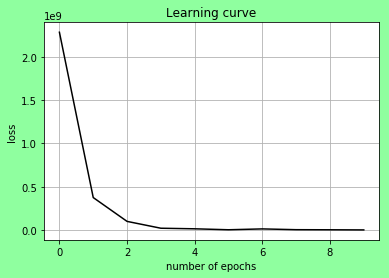

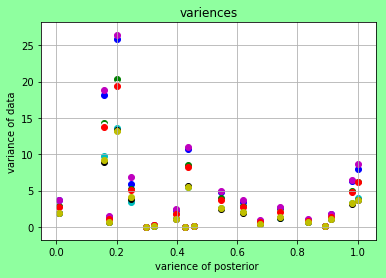

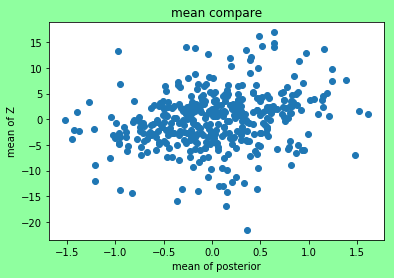

In [5]:

#this is to plot the graph 
fig = plt.figure()
fig.patch.set_facecolor('xkcd:mint green')
plt.ylabel('loss')
plt.xlabel('number of epochs')
plt.title('Learning curve')
df=pd.DataFrame(Loss.detach().numpy())
rolling_mean = df.rolling(window=1).mean()
plt.plot(ep, rolling_mean, label='Learning Curve', color='k')
plt.grid(True)
plt.show()



fig = plt.figure()
fig.patch.set_facecolor('xkcd:mint green')
plt.ylabel('variance of data')
plt.xlabel('varience of posterior ')
plt.title('variences')
plt.grid(True)
color=['b','c','k','g','w','m','r','y']
for a in range(8):
    
    
    Tr1=torch.ones(int(math.ceil(n/2)),dtype=torch.float)
    Tr2=torch.ones(int(round(n/2)),dtype=torch.float)
    Tr=torch.cat((Tr1,-Tr2),0)
    Transform=torch.diag(Tr)
    
    
    z_sample= torch.distributions.multivariate_normal.MultivariateNormal(mu,torch.inverse(Lamda))
    z1=z_sample.sample()
    z_softplus=F.softplus(z1)
    z=z_softplus@Transform
    

    


    Z=torch.zeros(T,m,1,n)
  
    for t in range(T):
        N=torch.randn(1,n)
        r=torch.relu(z)
        z_dot=(-z+(r@w1_rec+(x@w2))/math.sqrt(n))
        z = z + z_dot*dt+N*math.sqrt(dt)
        

        Z[t] = z

        Z_split = torch.split(Z,int(T/2),dim=0)[1]
        
        
      
       
        #pos_sample=torch.distributions.multivariate_normal.MultivariateNormal(pos2, Sigma)
        
        
        
    V=np.zeros((n,1),dtype=float)

    
  
    
    eigvalue_var,eigvector=np.linalg.eig(Sigma)
    #eigvalue_var=a.type(dtype=torch.float)
    
    
    #eig=torch.eig(Sigma,eigenvectors=True)
   # eigvalue_var=eig[0][:,0] #compute the varience along the eigenvector
    #torch.sort(eigvalue_var)[0]
    #eigvector=eig[1]

    for i in range(n):
        direction=eigvector[i].reshape(n,1)
        new_Z=(Z_split.detach().numpy()@direction)@np.transpose(direction)
        
        V[i]=np.var(new_Z[:,:,:,i])  
        
    plt.scatter(eigvalue_var,V,color=color[a])   
    #plt.plot(eigvalue_var.detach().numpy(),V.detach().numpy(),color=color[a]) 
    
    
    
plt.show() 



mean_Z2=torch.zeros(m,1,n)
for c in range(int(T)):
    for a in range (m):
        for b in range (n):
            mean_Z2[a,:,b]= mean_Z2[a,:,b] + Z[c,a,:,b]
            
mean_Z=mean_Z2/(int(T))





fig = plt.figure()
fig.patch.set_facecolor('xkcd:mint green')
plt.ylabel('mean of Z')
plt.xlabel('mean of posterior')
plt.title('mean compare')
plt.scatter(pos2.view(1,int(m*n)).detach().numpy(),mean_Z.view(1,int(m*n)).detach().numpy()) 







In [12]:
print (Z.view(1000*20*20).mean(),pos.view(400).mean())

tensor(-0.1369, grad_fn=<MeanBackward0>) tensor(0.0102)


In [ ]:
print (pos_sample.log_prob(0.01))